# Predict Positive or Negative Emotion (Fitbit Data + Survey Data, Stratified Split)

Author: Sicong Zhao

In [0]:
import pandas as pd
import numpy as np
!pip install catboost
import catboost
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GroupKFold, StratifiedKFold, cross_validate, cross_val_score, cross_val_predict

# Logistic Regression
from sklearn.linear_model import LinearRegression, Ridge, Lasso, BayesianRidge, SGDRegressor
from sklearn import preprocessing, metrics, svm
# Random Forest
from sklearn.ensemble import RandomForestRegressor

# KNN
from sklearn.neighbors import KNeighborsRegressor

# Decision Tree
from sklearn.tree import DecisionTreeRegressor

# Evaluation
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, recall_score, precision_score, f1_score, auc, roc_curve, precision_recall_curve, r2_score, mean_squared_error
import seaborn as sns

# Re-sample
from sklearn.utils import resample

     |████████████████████████████████| 64.0MB 58kB/s 


In [0]:
pd.set_option('display.max_rows', 1000)

## 1.Load Data

In [0]:
import pandas as pd
exp = pd.read_csv('exp_steps_hr_sleep_survey.csv')

In [0]:
exp[['la_p', 'ha_p', 'ha_n', 'la_n','la', 'p', 'n', 'ha']].corr()

,la_p,ha_p,ha_n,la_n,la,p,n,ha
la_p,1.000000,0.153796,-0.391650,0.053442,0.449374,0.507364,-0.281910,-0.043240
ha_p,0.153796,1.000000,-0.060527,-0.317859,-0.173720,0.482087,-0.184783,0.364081
ha_n,-0.391650,-0.060527,1.000000,0.017434,-0.211316,-0.374120,0.506088,0.102796
la_n,0.053442,-0.317859,0.017434,1.000000,0.326032,-0.170423,0.076326,-0.133293
la,0.449374,-0.173720,-0.211316,0.326032,1.000000,0.117915,-0.069231,-0.152627
p,0.507364,0.482087,-0.374120,-0.170423,0.117915,1.000000,-0.417586,0.157379
n,-0.281910,-0.184783,0.506088,0.076326,-0.069231,-0.417586,1.000000,-0.028102
ha,-0.043240,0.364081,0.102796,-0.133293,-0.152627,0.157379,-0.028102,1.000000


In [0]:
exp.reset_index(inplace=True) # Avoid error in cross validation

## 2.EDA (Skip)

Since we have alreaady done this in previous notebook

### (1) Missing Data Detection

In [0]:
missing_rate = exp.isna().sum()/exp.shape[0]
missing_rate

index                      0.000000
Unnamed: 0                 0.000000
subject                    0.000000
la_p                       0.000324
ha_p                       0.000000
ha_n                       0.000000
la_n                       0.000000
la                         0.000000
p                          0.000000
n                          0.000000
ha                         0.000000
start_survey               0.002595
survey_no                  0.000000
experiment                 0.000000
DATE_x                     0.000000
Period_of_day              0.002595
VALENCE                    0.000324
VALENCE_mean               0.000324
start_survey_5m_ahead      0.002595
start_survey_10m_ahead     0.002595
start_survey_30m_ahead     0.002595
start_survey_1h_ahead      0.002595
start_survey_3h_ahead      0.002595
survey_date                0.002595
subject_id_x               0.232241
step_max                   0.232241
step_min                   0.232241
step_median                0

In [0]:
# Columns with more than 50% missing
missing_mt_half_col = missing_rate[missing_rate > .5].index.values
missing_mt_half_col

array(['Date', 'Minutes Asleep', 'Minutes Awake', 'Number of Awakenings',
       'Time in Bed', 'DATE_y', 'ID', 'Experiment', 'Start Time',
       'End Time', 'Minutes REM Sleep', 'Minutes Light Sleep',
       'Minutes Deep Sleep', 'Openness', 'Agreeableness', 'Religion'],
      dtype=object)

In [0]:
# Columns with less than 50% missing
missing_lt_half_col = missing_rate[missing_rate <= .3].index.values
missing_lt_half_col

array(['index', 'Unnamed: 0', 'subject', 'la_p', 'ha_p', 'ha_n', 'la_n',
       'la', 'p', 'n', 'ha', 'start_survey', 'survey_no', 'experiment',
       'DATE_x', 'Period_of_day', 'VALENCE', 'VALENCE_mean',
       'start_survey_5m_ahead', 'start_survey_10m_ahead',
       'start_survey_30m_ahead', 'start_survey_1h_ahead',
       'start_survey_3h_ahead', 'survey_date', 'subject_id_x', 'step_max',
       'step_min', 'step_median', 'steps_max_3h', 'steps_min_3h',
       'steps_mean_3h', 'steps_var_3h', 'steps_median_3h', 'move_rate_3h',
       'active_rate_3h', 'very_active_rate_3h', 'running_rate_3h',
       'steps_max_1h', 'steps_min_1h', 'steps_mean_1h', 'steps_var_1h',
       'steps_median_1h', 'move_rate_1h', 'active_rate_1h',
       'very_active_rate_1h', 'running_rate_1h', 'steps_max_30m',
       'steps_min_30m', 'steps_mean_30m', 'steps_var_30m',
       'steps_median_30m', 'move_rate_30m', 'active_rate_30m',
       'very_active_rate_30m', 'running_rate_30m', 'steps_max_10m',
       

In [0]:
# Missingness of label
exp[['la_p', 'ha_p', 'ha_n', 'la_n','la', 'p', 'n', 'ha']].isna().sum()

la_p    1
ha_p    0
ha_n    0
la_n    0
la      0
p       0
n       0
ha      0
dtype: int64

### (2) Observe Labels

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f92970ac4e0>,
      dtype=object)

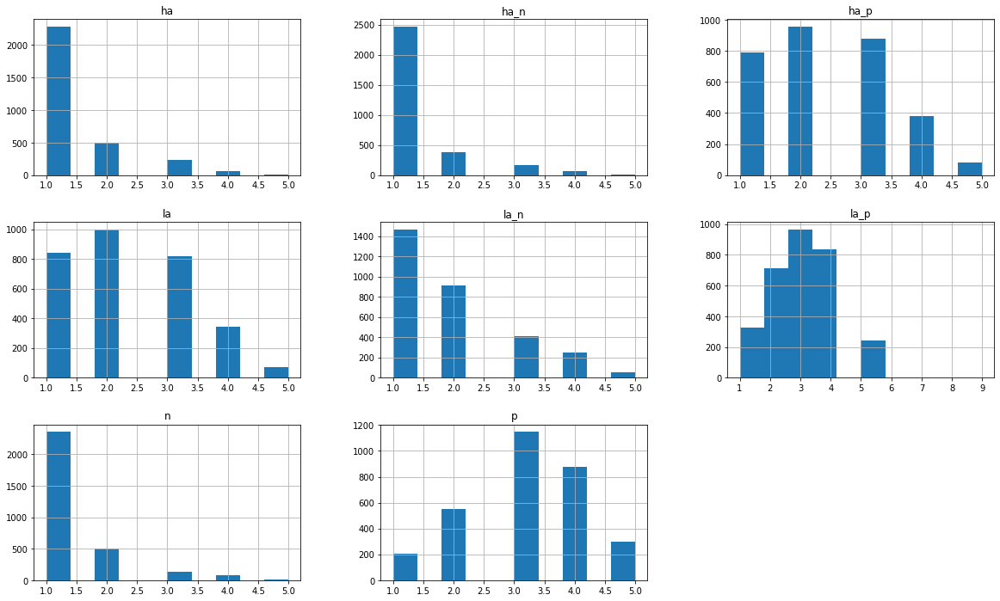

In [0]:
exp[['la_p', 'ha_p', 'ha_n', 'la_n','la', 'p', 'n', 'ha']].hist(figsize=(20,12))

In [0]:
exp[['la_p', 'ha_p', 'ha_n', 'la_n','la', 'p', 'n', 'ha']].describe()

,la_p,ha_p,ha_n,la_n,la,p,n,ha
count,3082.000000,3083.000000,3083.000000,3083.000000,3083.000000,3083.000000,3083.000000,3083.000000
mean,2.985075,2.356471,1.303925,1.866364,2.287707,3.163801,1.343172,1.390204
std,1.118914,1.071917,0.690207,1.030511,1.057988,1.044792,0.719372,0.751720
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,2.000000,1.000000,1.000000,1.000000,1.000000,3.000000,1.000000,1.000000
50%,3.000000,2.000000,1.000000,2.000000,2.000000,3.000000,1.000000,1.000000
75%,4.000000,3.000000,1.000000,2.000000,3.000000,4.000000,1.000000,2.000000
max,9.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


### (3) Observe Positive / Negative Emotion

In [0]:
# 'pn_raw' represent how happy / unhappy the subjects are
exp['pn_raw'] = (exp['la_p'] + exp['p'] + exp['ha_p'])/3 - (exp['la_n'] + exp['n'] + exp['ha_n'])/3

In [0]:
# Ratio of 'pn_raw' < 0
print('pn_raw < 0: ',str(sum(exp['pn_raw'] < 0)/exp.shape[0]))
print('pn_raw = 0: ',str(sum(exp['pn_raw'] == 0)/exp.shape[0]))
print('pn_raw > 0: ',str(sum(exp['pn_raw'] > 0)/exp.shape[0]))

pn_raw < 0:  0.10866039571845605
pn_raw = 0:  0.04573467401881284
pn_raw > 0:  0.8452805708725267


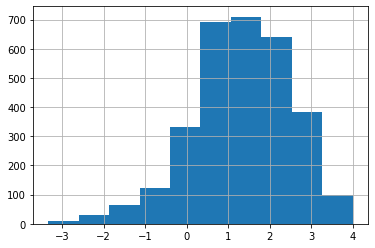

In [0]:
# Histogram of 'pn_raw'
exp['pn_raw'].hist()

## 3.Pre-processing

### (1) Grouping columns for different model
Let's only use predictors with less than 50% missing.

In [0]:
# Update Feature Cols

features_common = ['step_max', 'step_min', 'step_median', 
       
       'steps_max_3h', 'steps_min_3h', 'steps_mean_3h', 'steps_var_3h', 'steps_median_3h', 
       'move_rate_3h', 'active_rate_3h', 'very_active_rate_3h', 'running_rate_3h',
       
       'steps_max_1h', 'steps_min_1h', 'steps_mean_1h', 'steps_var_1h', 'steps_median_1h', 
       'move_rate_1h', 'active_rate_1h', 'very_active_rate_1h', 'running_rate_1h', 
       
       'steps_max_30m', 'steps_min_30m', 'steps_mean_30m', 'steps_var_30m', 'steps_median_30m', 
       'move_rate_30m', 'active_rate_30m', 'very_active_rate_30m', 'running_rate_30m', 
       
       'steps_max_10m', 'steps_min_10m', 'steps_mean_10m', 'steps_var_10m', 'steps_median_10m', 
       'move_rate_10m', 'active_rate_10m', 'very_active_rate_10m', 'running_rate_10m', 
       
       'steps_max_5m', 'steps_min_5m', 'steps_mean_5m', 'steps_var_5m', 'steps_median_5m',
       'move_rate_5m', 'active_rate_5m', 'very_active_rate_5m', 'running_rate_5m', 
       
       'hr_max', 'hr_min', 'hr_med',
       
       'SDNN_3h', 'pHR2_3h', 'rMSSD_3h', 'low_hr_3h', 'high_hr_3h', 'l_h_3h', 'CR_3h', 'hr_mean_3h', 
       'hr_var_3h', 'hr_std_3h', 'hr_median_3h', 'hr_rest_rate_3h', 'hr_moderate_rate_3h',
       'hr_very_active_rate_3h', 
       
       'SDNN_1h', 'pHR2_1h', 'rMSSD_1h', 'low_hr_1h', 'high_hr_1h', 'l_h_1h', 'CR_1h', 'hr_mean_1h',
       'hr_var_1h', 'hr_std_1h', 'hr_median_1h', 'hr_rest_rate_1h',
       'hr_moderate_rate_1h', 'hr_very_active_rate_1h', 
       
       'SDNN_30m', 'pHR2_30m', 'rMSSD_30m', 'low_hr_30m', 'high_hr_30m', 'l_h_30m', 'CR_30m', 'hr_mean_30m', 
       'hr_var_30m', 'hr_std_30m', 'hr_median_30m', 'hr_rest_rate_30m', 
       'hr_moderate_rate_30m', 'hr_very_active_rate_30m', 
       
       'SDNN_10m', 'pHR2_10m', 'rMSSD_10m', 'low_hr_10m', 'high_hr_10m', 'l_h_10m', 'CR_10m', 'hr_mean_10m',
       'hr_var_10m', 'hr_std_10m', 'hr_median_10m', 'hr_rest_rate_10m',
       'hr_moderate_rate_10m', 'hr_very_active_rate_10m', 
       
       'SDNN_5m', 'pHR2_5m', 'rMSSD_5m', 'low_hr_5m', 'high_hr_5m', 'l_h_5m',
       'CR_5m', 'hr_mean_5m', 'hr_var_5m', 'hr_std_5m', 'hr_median_5m',
       'hr_rest_rate_5m', 'hr_moderate_rate_5m', 'hr_very_active_rate_5m',
       
       'hr_0', 'hr_0.3', 'hr_0.5', 'hr_0.8', 'hr_1', 
       
       'SBQ', 'FTP', 'SWLS', 'Neuroticism', 'Extraversion', 'Conscientiousness',
       'NS_total', 'BIS_total', 'BIS.5', 'BAS_D', 'BAS_FS', 'BAS_RR',
       'HAP_actual', 'P_actual', 'LAP_actual', 'LA_actual', 'LAN_actual',
       'N_actual', 'HAN_actual', 'HA_actual', 'HAP_ideal', 'P_ideal',
       'LAP_ideal', 'LA_ideal', 'LAN_ideal', 'N_ideal', 'HAN_ideal',
       'HA_ideal', 'survey_hour'
       
       ]

features_lite = ['step_max', 'step_min', 'step_median', 
       
      #  'steps_max_3h', 'steps_min_3h', 'steps_mean_3h', 'steps_var_3h', 'steps_median_3h', 
      #  'move_rate_3h', 'active_rate_3h', 'very_active_rate_3h', 'running_rate_3h',
       
       'steps_max_1h', 'steps_min_1h', 
       'steps_var_1h', 'steps_median_1h', 
       'active_rate_1h', 
       #'move_rate_1h', 'very_active_rate_1h', 'steps_mean_1h', 'running_rate_1h',  
       
      #  'steps_max_30m', 'steps_min_30m', 'steps_mean_30m', 'steps_var_30m', 'steps_median_30m', 
      #  'move_rate_30m', 'active_rate_30m', 'very_active_rate_30m', 'running_rate_30m', 
       
       'steps_max_10m', 'steps_min_10m', 
       'steps_var_10m', 'steps_median_10m', 
       'move_rate_10m', 
       # 'very_active_rate_10m', 'active_rate_10m', 'steps_mean_10m',
       'running_rate_10m', 
       
      #  'steps_max_5m', 'steps_min_5m', 'steps_mean_5m', 'steps_var_5m', 'steps_median_5m',
      #  'move_rate_5m', 'active_rate_5m', 'very_active_rate_5m', 'running_rate_5m', 
       
       'hr_max', 'hr_min', 'hr_med',
       
       'SDNN_3h', 'pHR2_3h', 'rMSSD_3h', 'low_hr_3h', 'high_hr_3h', 'l_h_3h', 'CR_3h', 
      #  'hr_mean_3h', 
      #  'hr_var_3h', 'hr_std_3h', 'hr_median_3h', 'hr_rest_rate_3h', 'hr_moderate_rate_3h',
      #  'hr_very_active_rate_3h', 
       
       'SDNN_1h', 'pHR2_1h', 'high_hr_1h', 'l_h_1h', 'hr_mean_1h',
       #'rMSSD_1h', 'low_hr_1h', 'CR_1h', 'hr_median_1h', 'hr_var_1h', 
       'hr_std_1h', 'hr_rest_rate_1h',
       'hr_moderate_rate_1h', 'hr_very_active_rate_1h', 
       
       'SDNN_30m', 'pHR2_30m', 'rMSSD_30m', 'low_hr_30m', 'high_hr_30m', 'l_h_30m', 'CR_30m', 
      #  'hr_mean_30m', 
      #  'hr_var_30m', 'hr_std_30m', 'hr_median_30m', 'hr_rest_rate_30m', 
      #  'hr_moderate_rate_30m', 'hr_very_active_rate_30m', 
       
       'SDNN_10m', 'pHR2_10m', 'rMSSD_10m', 'l_h_10m', 
       # 'hr_mean_10m', 'hr_var_10m', 'hr_median_10m', 'low_hr_10m', 'high_hr_10m', 'CR_10m', 
       'hr_std_10m',  'hr_rest_rate_10m',
       'hr_moderate_rate_10m', 'hr_very_active_rate_10m', 
       
       'SDNN_5m', 'pHR2_5m', 'rMSSD_5m', 'low_hr_5m', 'high_hr_5m', 'l_h_5m',
       'CR_5m', 
      #  'hr_mean_5m', 'hr_var_5m', 'hr_std_5m', 'hr_median_5m',
      #  'hr_rest_rate_5m', 'hr_moderate_rate_5m', 'hr_very_active_rate_5m',
       
       'hr_0', 'hr_0.3', 'hr_0.8', 'hr_1', # 'hr_0.5',
       
       'SBQ', 'SWLS', 'Neuroticism', 'Extraversion', 
       'NS_total', 'BIS_total', 'BIS.5', 'BAS_D', 'BAS_FS', 'BAS_RR',
       'Age', 'BMI', 'Children',
      # 'FTP', 'Conscientiousness',
      #  'HAP_actual', 'P_actual', 'LAP_actual', 'LA_actual', 'LAN_actual',
      #  'N_actual', 'HAN_actual', 'HA_actual', 'HAP_ideal', 'P_ideal',
      #  'LAP_ideal', 'LA_ideal', 'LAN_ideal', 'N_ideal', 'HAN_ideal',
      #  'HA_ideal', 
      'survey_hour'
       
       ]


feature_encode = ['exp', 'income', 'have_med', 'is_female',
                'is_married', 'is_divorced', 'is_single', 'is_widowed', 
                'is_with_partner', 'is_wht', 'is_hsp_other', 'is_blk', 
                'is_hsp_caucasian', 'is_birace', 'is_hsp', 'is_asn', 
                'is_white_pacific', 'is_hwi', 'edu_hs', 'edu_ba', 'edu_ma', 
                'edu_phd']
feature_ca = ['edu', 'Ethnicity', 'Sex', 'Marital_Status',
              'have_med', 'experiment']
subject = ['subject']
feature_num = features_common + feature_encode + subject
feature_num_lite = features_lite + feature_encode
feature_cols_ca = features_common + feature_ca
label_cols = ['la_p', 'ha_p', 'ha_n', 'la_n', 'la', 'p', 'n', 'ha']

In [0]:
# Generate design matrix
exp.loc[:,'edu'] = 0
exp.loc[:,'have_med'] = 0

design_matrix = exp[features_common + feature_ca + label_cols + subject]

In [0]:
design_matrix.shape

(3083, 170)

### (2) Generate Labels

In [0]:
exp['p_score'] = (exp['la_p'] + exp['p'] + exp['ha_p'])/3 
exp['n_score'] = (exp['la_n'] + exp['n'] + exp['ha_n'])/3
exp['valence_score'] = exp['p_score'] - exp['n_score']

In [0]:
# Create dummy variable for valence, with 1 to be unhappy, and 0 to be happy.
exp.loc[:,'valence'] = 0
exp.loc[exp['valence_score'] <= 0, 'valence'] = 1

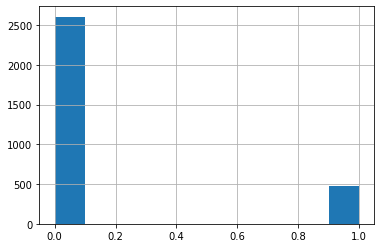

In [0]:
exp['valence'].hist()

As you can see, this is very imbalanced data. Let's use a logistic regression to start.

### (3) Encode Categorical Data

i. List All Categorical Data

In [0]:
# Categorical Features
exp.columns[exp.dtypes == 'object']

Index(['subject', 'start_survey', 'experiment', 'DATE_x', 'Period_of_day',
       'start_survey_5m_ahead', 'start_survey_10m_ahead',
       'start_survey_30m_ahead', 'start_survey_1h_ahead',
       'start_survey_3h_ahead', 'survey_date', 'subject_id_x', 'subject_id_y',
       'Date', 'Experiment', 'Subject', 'Education', 'Ethnicity', 'Sex',
       'Marital_Status', 'Household_income', 'Religion', 'Medications'],
      dtype='object')

ii. Convert Education

In [0]:
exp['Education'].unique()

MBA = ['MBA', 'High School Diploma, BA, MBA', 'B.S. Business Management', 'BS Business','College grad']
Art = ['Bachelor of Arts', 'Bachelor of Arts + Equivalency Degree', 'Bachelor Degree Music Ed']
Med = ['Medical Degree', 'B.A. English/Spanish B.S. Nursing', 'BSN- bachelors of science in nursing']
Psy = ['Education specialist in School Psy, M.A. in Educational Psy', 'M.S. Psychology/ B.A. Sociology', 'B.S. Psychology Texas A&M']


HighSchool = ['12.0','high school', 'High School', 'high school + cosmetology school', 'High School Graduate']
BA = ['Some college', 'B.A. English/Spanish B.S. Nursing', 'B.S. working on MD and MTS', 'B.S.  Mechanical Engineering', 
      "Bachelor's Degree", 'B.A.', 'College student 3 years', 'B.A. from Cornell Univ.', 'Bachelors degree in Social Work', 
      'BS', 'BA Vanderbilt', 'BS Communications', "college graduate (bachelor's degree in Music from Belmont University)",
      'Bachelor of Arts', 'BSN- bachelors of science in nursing', 'BSE Princeton',
      'Obtained B.S., 2011', 'bachelor of science', 'Bachelor of Social Work', 'B.S.', 'BBA - Bachelors', 'BSC Communications',
      'B.A. 1988', 'B.S. degree dietetics, internship', 'Bachelor of Arts + Equivalency Degree', 'Bachelors', 'B.S. Business Management',
      'B.S. Psychology Texas A&M', 'BS Journalism; BS Nutrition', 'B.E.Sc.', 'Bachelor Degree Music Ed', 'NDCDP',
      'BS Math/Computer Science', 'BS Business', 'college graduate','14.0','16.0']
Master = MBA + ['College, Masters',"Bachelor of science, 1 year of Master's",'Masters; PhD ongoing', 'M.S. Psychology/ B.A. Sociology',
                'B.S., MPH','18.0', '19.0']
PhD = ['Ph.D.', 'PhD Candidate', 'PhD', 'BS. (PhD Student currently)', 'Masters; PhD ongoing', 
       'Pursuing PhD at Vanderbilt. Have B.S. from UTK', 'BA from Stanford, JD from Univ of Michigan','21.0', '22.0', '20.0']

In [0]:
# design_matrix['is_MBA'] = 0
# design_matrix.loc[design_matrix['Education'].isin(MBA), 'is_MBA'] = 1
# design_matrix['is_Art'] = 0
# design_matrix.loc[design_matrix['Education'].isin(Art), 'is_Art'] = 1
# design_matrix['is_Med'] = 0
# design_matrix.loc[design_matrix['Education'].isin(Med), 'is_Med'] = 1
# design_matrix['is_Psy'] = 0
# design_matrix.loc[design_matrix['Education'].isin(Psy), 'is_Psy'] = 1

exp.loc[:,'edu'] = 0
exp.loc[:,'edu_hs'] = 0
exp.loc[exp['Education'].isin(HighSchool), 'edu_hs'] = 1
exp.loc[exp['Education'].isin(HighSchool), 'edu'] = 'high school'
exp.loc[:,'edu_ba'] = 0
exp.loc[exp['Education'].isin(BA), 'edu_ba'] = 1
exp.loc[exp['Education'].isin(BA), 'edu'] = 'undergrad'
exp.loc[:,'edu_ma'] = 0
exp.loc[exp['Education'].isin(Master), 'edu_ma'] = 1
exp.loc[exp['Education'].isin(Master), 'edu'] = 'master'
exp.loc[:,'edu_phd'] = 0
exp.loc[exp['Education'].isin(PhD), 'edu_phd'] = 1
exp.loc[exp['Education'].isin(PhD), 'edu'] = 'phd'

iii. Convert Ethnicity

In [0]:
design_matrix['Ethnicity'].unique()

array(['White', 'Hispanic/Other', 'Black', 'Hispanic/Caucasian',
       'Biracial', 'Hispanic', 'Asian', 'White/Pacific Islander', nan,
       'Native Hawaiian/Pacific Islander', 'More than 1 race'],
      dtype=object)

In [0]:
exp.loc[:,'is_wht'] = 0
exp.loc[exp['Ethnicity'] == 'White', 'is_wht'] = 1
exp.loc[:,'is_hsp_other'] = 0
exp.loc[exp['Ethnicity'] == 'Hispanic/Other', 'is_hsp_other'] = 1
exp.loc[:,'is_blk'] = 0
exp.loc[exp['Ethnicity'] == 'Black', 'is_blk'] = 1
exp.loc[:,'is_hsp_caucasian'] = 0
exp.loc[exp['Ethnicity'] == 'Hispanic/Caucasian', 'is_hsp_caucasian'] = 1
exp.loc[:,'is_birace'] = 0
exp.loc[exp['Ethnicity'].isin(['Biracial', 'More than 1 race']), 'is_birace'] = 1
exp.loc[:,'is_hsp'] = 0
exp.loc[exp['Ethnicity'] == 'Hispanic', 'is_hsp'] = 1
exp.loc[:,'is_asn'] = 0
exp.loc[exp['Ethnicity'] == 'Asian', 'is_asn'] = 1
exp.loc[:,'is_white_pacific'] = 0
exp.loc[exp['Ethnicity'] == 'White/Pacific Islander', 'is_white_pacific'] = 1
exp.loc[:,'is_hwi'] = 0
exp.loc[exp['Ethnicity'] == 'Native Hawaiian/Pacific Islander', 'is_hwi'] = 1

iv. Sex

In [0]:
exp['Sex'].unique()
# Drop NA in Sex column
exp = exp[~exp['Sex'].isna()]
exp.shape

(3058, 227)

In [0]:
exp['is_female'] = 0
exp.loc[exp['Sex'] == 'Female', 'is_female'] = 1

v. Marital_Status

In [0]:
exp['Marital_Status'].unique()

array(['Married', 'Divorced', 'Single', 'Engaged', 'Widowed',
       'Living with partner'], dtype=object)

In [0]:
exp.loc[:,'is_married'] = 0
exp.loc[design_matrix['Marital_Status'] == 'Married', 'is_married'] = 1
exp.loc[:,'is_divorced'] = 0
exp.loc[design_matrix['Marital_Status'] == 'Divorced', 'is_divorced'] = 1
exp.loc[:,'is_single'] = 0
exp.loc[design_matrix['Marital_Status'] == 'Single', 'is_single'] = 1
exp.loc[:,'is_widowed'] = 0
exp.loc[design_matrix['Marital_Status'] == 'Widowed', 'is_widowed'] = 1
exp.loc[:,'is_with_partner'] = 0
exp.loc[design_matrix['Marital_Status'] == 'Living with partner', 'is_with_partner'] = 1

vi. Household_income

In [0]:
exp['Household_income'].unique()
# Drop NA in Household_income column
exp = exp[~exp['Household_income'].isna()]
exp.shape

(3029, 233)

In [0]:
exp.loc[:,'income'] = 0
exp.loc[exp['Household_income'] == '$10,000-$19,999', 'income'] = 1
exp.loc[exp['Household_income'] == '$20,000-$29,999', 'income'] = 2
exp.loc[exp['Household_income'] == '$30,000-$39,999', 'income'] = 3
exp.loc[exp['Household_income'] == '$40,000-$49,999', 'income'] = 4
exp.loc[exp['Household_income'] == '$50,000-$59,999', 'income'] = 5
exp.loc[exp['Household_income'] == '$60,000-$69,999', 'income'] = 6
exp.loc[exp['Household_income'] == '$70,000-$79,999', 'income'] = 7
exp.loc[exp['Household_income'] == '$80,000-$89,999', 'income'] = 8
exp.loc[exp['Household_income'] == '$90,000-$99,999', 'income'] = 9
exp.loc[exp['Household_income'] == '$100,000-$109,999', 'income'] = 10
exp.loc[exp['Household_income'] == '$110,000-$119,999', 'income'] = 11
exp.loc[exp['Household_income'] == '$120,000-$129,999', 'income'] = 12
exp.loc[exp['Household_income'] == '$130,000-$139,000', 'income'] = 13
exp.loc[exp['Household_income'] == '$140,000-$149,999', 'income'] = 14
exp.loc[exp['Household_income'].isin(['$150,000 or more ','$150,000 or more']), 'income'] = 15

vii. Medications

In [0]:
exp['Medications'].unique()

array(['None', 'None listed', 'BP med, cholesterol med', 'Camrese',
       'Ortho-tri-sprintic (oral contraceptive)', 'Birth control (oral)',
       'Occaisonal OTC allergy and/or cold medicine',
       'Pravachol, Claritin', 'Naproxen, omeprazole',
       'Adult multivitamin, fish oil supplement, Vitamin E, Calcium+ Vitamin D supplement, Magnesium Oxide Supplement, D3 supplement, Biotin',
       'Aciphex', 'Levothyroxin, provastatin',
       'Lipitor, Diovan, 81mg Aspirin', 'Curbimide, Thyroid Med, Aspirin',
       'Vit D3, Levonogestrel/ethinyl, estradiol',
       'Lisinopril, water pill', 'Atorvastatin', 'IUD birth control',
       'Aspirin as needed', nan, 'Loloestrin', 'Mossa', 'birth control',
       'finasteride', 'Lutera (birth control)', 'lo-ogestrel (cryselle)',
       'Vitamin D supplements', 'albuterol was needed for asthma',
       'Reclipsen (Birth Control Pill)', 'Portia',
       'Mobic - antiinflammatory', 'clobetasol',
       'Spironolactone 100 mg PO Q Day',
       't

In [0]:
exp.loc[:,'have_med'] = 1
exp.loc[exp['Medications'] == 'None', 'have_med'] = 0

viii. Exp

In [0]:
# 'DND' = 0, 'ROO' = 1
exp['exp'] = 1
exp.loc[exp['experiment'] == 'DND', 'exp'] = 0

### (4) Detect Correlation

In [0]:
corr_matrix = exp[feature_num].corr()
corr_matrix_df = pd.DataFrame(corr_matrix.unstack())
corr_matrix_df.columns = ['corr']

# Filter pairs which are highly correlated
corr_matrix_df[(corr_matrix_df['corr'] > 0.9) & (corr_matrix_df['corr'] < 1)]

corr
steps_mean_3h           very_active_rate_3h      0.944557
                        running_rate_3h          0.970005
move_rate_3h            active_rate_3h           0.982064
                        very_active_rate_3h      0.928990
active_rate_3h          move_rate_3h             0.982064
                        very_active_rate_3h      0.973290
                        running_rate_3h          0.917322
very_active_rate_3h     steps_mean_3h            0.944557
                        move_rate_3h             0.928990
                        active_rate_3h           0.973290
                        running_rate_3h          0.977516
running_rate_3h         steps_mean_3h            0.970005
                        active_rate_3h           0.917322
                        very_active_rate_3h      0.977516
steps_mean_1h           very_active_rate_1h      0.927333
                        running_rate_1h          0.959266
move_rate_1h            active_rate_1h           0.972596
                        very_active_rate_1h      0.909354
active_rate_1h          move_rate_1h             0.972596
                        very_active_rate_1h      0.967026
                        running_rate_1h          0.905872
very_active_rate_1h     steps_mean_1h            0.927333
                        move_rate_1h             0.909354
                        active_rate_1h           0.967026
                        running_rate_1h          0.972520
running_rate_1h         steps_mean_1h            0.959266
                        active_rate_1h           0.905872
                        very_active_rate_1h      0.972520
steps_mean_30m          steps_median_30m         0.920333
                        very_active_rate_30m     0.923085
                        running_rate_30m         0.957074
steps_median_30m        steps_mean_30m           0.920333
move_rate_30m           active_rate_30m          0.969008
                        very_active_rate_30m     0.901710
active_rate_30m         move_rate_30m            0.969008
                        very_active_rate_30m     0.961484
very_active_rate_30m    steps_mean_30m           0.923085
                        move_rate_30m            0.901710
                        active_rate_30m          0.961484
                        running_rate_30m         0.966914
running_rate_30m        steps_mean_30m           0.957074
                        very_active_rate_30m     0.966914
steps_mean_10m          steps_median_10m         0.951602
                        very_active_rate_10m     0.909685
                        running_rate_10m         0.942009
                        steps_mean_5m            0.902805
steps_median_10m        steps_mean_10m           0.951602
move_rate_10m           active_rate_10m          0.953320
                        move_rate_5m             0.904177
active_rate_10m         move_rate_10m            0.953320
                        very_active_rate_10m     0.941897
very_active_rate_10m    steps_mean_10m           0.909685
                        active_rate_10m          0.941897
                        running_rate_10m         0.940211
running_rate_10m        steps_mean_10m           0.942009
                        very_active_rate_10m     0.940211
steps_max_5m            steps_mean_5m            0.906970
steps_mean_5m           steps_mean_10m           0.902805
                        steps_max_5m             0.906970
                        steps_median_5m          0.966001
                        running_rate_5m          0.923614
steps_median_5m         steps_mean_5m            0.966001
move_rate_5m            move_rate_10m            0.904177
                        active_rate_5m           0.939527
active_rate_5m          move_rate_5m             0.939527
                        very_active_rate_5m      0.921852
very_active_rate_5m     active_rate_5m           0.921852
                        running_rate_5m          0.916397
running_rate_5m         steps_mean_5m            0.

As we can see, the correlation exist in 'mean' and 'median' fetaures, 'var' and 'std' features. Let's get rid of them by changing feature columns.

In [0]:
# Check correlation again
corr_matrix = exp[feature_num_lite].corr()
corr_matrix_df = pd.DataFrame(corr_matrix.unstack())
corr_matrix_df.columns = ['corr']
# Filter pairs which are highly correlated
corr_matrix_df[(corr_matrix_df['corr'] > 0.9) & (corr_matrix_df['corr'] < 1)]

,,corr
hr_med,hr_0.3,0.950809
hr_0.3,hr_med,0.950809


### (5) Split the Data with one-hot encoding by Subject

In [0]:
# Construct design matrix for logistic regression. Categorical features are one-hot encoded
design_matrix_onehot = exp[feature_num_lite + subject + ['valence', 'valence_score', 'p_score', 'n_score']].dropna()
design_matrix_onehot.shape

(2133, 100)

In [0]:
# Grouped Data-Split, by subject, prevent information leakage
X_oh = design_matrix_onehot[feature_num_lite]
y_oh = design_matrix_onehot[['p_score', 'n_score']]
group_oh = design_matrix_onehot['subject']
y_val = design_matrix_onehot['valence']
group = design_matrix_onehot['subject'].values
gkf_modeling = list(StratifiedKFold(n_splits=4).split(X_oh,y_val,group))

X_oh_train = X_oh.iloc[gkf_modeling[1][0],]
X_oh_test = X_oh.iloc[gkf_modeling[1][1],]
y_oh_train = y_oh.iloc[gkf_modeling[1][0],]
y_oh_test = y_oh.iloc[gkf_modeling[1][1],]

# Normalization
scaler = preprocessing.StandardScaler().fit(X_oh_train)
X_oh_train_scaled = scaler.transform(X_oh_train)
X_oh_test_scaled = scaler.transform(X_oh_test)

### (6) Split the Data with categorical feature by Subject

In [0]:
# Construct design matrix for lther regression. Categorical features are not one-hot encoded
design_matrix_for_cat = exp[feature_cols_ca + subject + ['valence','valence_score','p_score', 'n_score']].dropna()
design_matrix_for_cat.shape

(2133, 166)

In [0]:
# Grouped Data-Split, by subject, prevent information leakage
X_cat = design_matrix_for_cat[feature_cols_ca]
y_cat = design_matrix_for_cat[['p_score', 'n_score']]
group_cat = design_matrix_for_cat['subject']

X_cat_train = X_cat.iloc[gkf_modeling[1][0],]
X_cat_test = X_cat.iloc[gkf_modeling[1][1],]
y_cat_train = y_cat.iloc[gkf_modeling[1][0],]
y_cat_test = y_cat.iloc[gkf_modeling[1][1],]

## 4.Cross Validation with Basic Models (Skip for now)

In [0]:
scoring = {
    # 'explained_variance': 'explained_variance',
    'r2': 'r2',
    'rmse':'neg_root_mean_squared_error'
}

In [0]:
def avg_dict(dict):
  avgDict = {}
  for k,v in dict.items():
      avgDict[k] = sum(v)/ float(len(v))
  return avgDict

In [0]:

# Information about scoring metrics
models = [LinearRegression(), Ridge(), Lasso(), svm.SVR(), BayesianRidge(), SGDRegressor(), 
          KNeighborsRegressor(n_neighbors=10), DecisionTreeRegressor(), RandomForestRegressor()]
model_names = ['Linear', 'Ridge', 'Lasso', 'svm', 'BayesianRidge', 'SGDRegressor', 'KNN', 'DecisionTreeRegressor', 'RandomForest']

for model, name in zip(models, model_names):
  print(name)
  scores_p = cross_validate(model, X_oh, y_oh['p_score'], cv=gkf_modeling, scoring=scoring)
  scores_n = cross_validate(model, X_oh, y_oh['n_score'], cv=gkf_modeling, scoring=scoring)

  print('scores_p: ', avg_dict(scores_p))
  print('scores_n: ', avg_dict(scores_n))

Linear
scores_p:  {'fit_time': 0.02503502368927002, 'score_time': 0.0032561421394348145, 'test_r2': -0.321334897943404, 'test_rmse': -0.9407925303023168}
scores_n:  {'fit_time': 0.020794570446014404, 'score_time': 0.004621565341949463, 'test_r2': -0.1411160879357607, 'test_rmse': -0.5814736142581648}
Ridge
scores_p:  {'fit_time': 0.009198248386383057, 'score_time': 0.003439486026763916, 'test_r2': -0.2724291816891478, 'test_rmse': -0.9239619016762529}
scores_n:  {'fit_time': 0.008816719055175781, 'score_time': 0.0029546022415161133, 'test_r2': -0.11134607553803666, 'test_rmse': -0.5740628931015168}
Lasso
scores_p:  {'fit_time': 0.009416520595550537, 'score_time': 0.0035678744316101074, 'test_r2': -0.03349209122026667, 'test_rmse': -0.8334229590150728}
scores_n:  {'fit_time': 0.00819176435470581, 'score_time': 0.0031850337982177734, 'test_r2': 0.0028430490458359325, 'test_rmse': -0.5440454905345475}
svm
scores_p:  {'fit_time': 0.5148912072181702, 'score_time': 0.13392722606658936, 'test

Lasso, SVM, Bayesian Ridge performs the best. Let's use these three as our baseline with catboost.

## 5.House keeping

Useful functions that help training

In [0]:
def convert_reg_to_class(y_regr):
  return [0 if x >= 0 else 1 for x in y_regr]

def eval_reg(y_test, y_pred):
  '''
  This function evaluates the regression model performance
  in terms of RMSE, R2
  
  Parameters:
  y_test (array):     Test label
  y_pred (array):     Model prediction

  Returns:
  Evaluation information printed
  array contains [RMSE, r2]
  '''
  RMSE = mean_squared_error(y_test, y_pred)
  r2 = r2_score(y_test, y_pred)
  print('RMSE: \t', str(RMSE))
  print('r2: \t', str(r2))
  return [RMSE, r2]

def eval_class(y_test, y_pred):
  '''
  This function evaluates the model performance
  in terms of Accuracy, Recall, Precision, Specificity and F1
  
  Parameters:
  y_test (array):     Test label
  y_pred (array):     Model prediction

  Returns:
  Evaluation information printed
  array contains [accuracy, recall, precision, specificity, npv, f1]
  '''
  # Accuracy
  accuracy = accuracy_score(y_test, y_pred)
  recall = recall_score(y_test, y_pred)
  precision = precision_score(y_test, y_pred)
  tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
  specificity = tn / (tn+fp)
  npv = tn / (tn+fn)
  f1 = f1_score(y_test, y_pred)

  print('Accuracy: \t', str(accuracy))
  print('Recall: \t', str(recall))
  print('Precision: \t', str(precision))
  print('Specificity: \t', str(specificity))
  print('NPV: \t', str(npv))
  print('F1: \t\t', str(f1))
  return [accuracy, recall, precision, specificity, npv, f1]

def confision_matrix(y_test, y_pred, model_name):
  '''
  This function plots confision matrix for classfication algotrithms.
  
  Parameters:
  y_test (array):     Test label
  y_pred (array):     Model prediction
  model_type (string):  Model names

  Returns: 
  Confusion Matrix plot
  '''
  cm_2 = confusion_matrix(y_test, y_pred) 
  cm_2_df = pd.DataFrame(cm_2)

  plt.figure(figsize=(5.5,4))
  sns.heatmap(cm_2_df, annot=True)
  accuracy = accuracy_score(y_test, y_pred)
  plt.title(model_name + ' Confusion Matrix \nAccuracy:{0:.3f}'.format(accuracy))
  plt.ylabel('True label')
  plt.xlabel('Predicted label')
  plt.show()

def eval(y_test, y_regr, model_name):
  y_pred = convert_reg_to_class(y_regr)
  y_test_cls = convert_reg_to_class(y_test)
  confision_matrix(y_test_cls, y_pred, model_name)
  reg_metrics = eval_reg(y_test, y_regr)
  cls_metrics = eval_class(y_test_cls, y_pred)
  return reg_metrics + cls_metrics

def catboost_feature_importance(model, feature_col):
  # Extract feature importance
  feature_importance = pd.Series(model.feature_importances_)
  feature_name = pd.Series(feature_col)
  feature_importance_score = pd.DataFrame(dict(feature_name = feature_name, score = feature_importance))
  # Sort by score
  # return feature_importance_score.sort_values(by='score', ascending=False)
  print(feature_importance_score.head(20))

def model_pn(model_type, X_train, y_train, X_test, y_test, model_name):
  if model_name == 'CatBoost':
    params_1 = {
      'iterations': 10000,
      'loss_function': 'RMSE',
      'eval_metric': 'RMSE',
      'verbose': 10,
      'random_seed': 24,
      # 'depth':6, 
      'learning_rate':0.01,
      'use_best_model': True,
      'l2_leaf_reg': 10,
      'bagging_temperature': 3,
      'od_type': "Iter",
      'od_wait': 100
    }
    categorical_features_indices = np.where(X_train.dtypes != np.float)[0]
    model_p = catboost.CatBoostRegressor(**params_1)
    model_p.fit(X_train, y_train['p_score'],
                eval_set = (X_test, y_test['p_score']),
                use_best_model = True,
                cat_features = categorical_features_indices,
                plot=True)
    p_regr = model_p.predict(X_test)

    model_n = catboost.CatBoostRegressor(**params_1)
    model_n.fit(X_train, y_train['n_score'],
                eval_set = (X_test, y_test['n_score']),
                use_best_model = True,
                cat_features = categorical_features_indices,
                plot=True)
    n_regr = model_n.predict(X_test)
    print('Feature importance of positive model:')
    catboost_feature_importance(model_p, X_train.columns.values)
    print('Feature importance of negative model:')
    catboost_feature_importance(model_n, X_train.columns.values)
  else:
    model_p = model_type
    model_n = model_type
    model_p.fit(X_train, y_train['p_score'])
    p_regr = model_p.predict(X_test)
    model_n.fit(X_train, y_train['n_score'])
    n_regr = model_n.predict(X_test)

  model_regr = p_regr - n_regr
  y_valence = y_test['p_score'] - y_test['n_score']
  # print(model_regr)
  return eval(y_valence, model_regr, model_name)

## 6.Baseline Model - Lasso

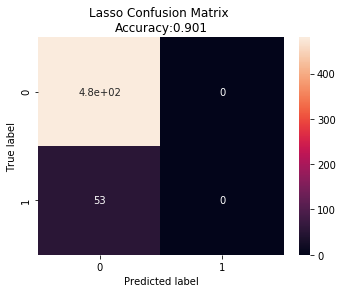

RMSE: 	 1.5535263983348966
r2: 	 -0.015127491917449332
Accuracy: 	 0.900562851782364
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.900562851782364
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [0]:
ls = model_pn(Lasso(max_iter=20000), X_oh_train_scaled, y_oh_train, X_oh_test_scaled, y_oh_test, 'Lasso')

All results are 1, we are suffering from imbalanced data. Let's try Random Forest.

## 7.Support Vector Machine

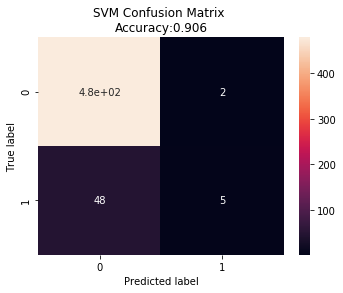

RMSE: 	 1.5351416618121534
r2: 	 -0.003114273799045497
Accuracy: 	 0.9061913696060038
Recall: 	 0.09433962264150944
Precision: 	 0.7142857142857143
Specificity: 	 0.9958333333333333
NPV: 	 0.908745247148289
F1: 		 0.16666666666666669


In [0]:
svm_ = model_pn(svm.SVR(), X_oh_train_scaled, y_oh_train, X_oh_test_scaled, y_oh_test, 'SVM')

Still not perform well. Let's try to model using random split data.

## 8.Bayesian Ridge

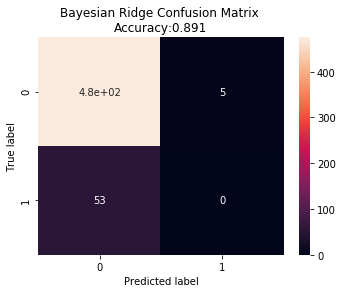

RMSE: 	 1.5397123989236212
r2: 	 -0.006100950372518232
Accuracy: 	 0.8911819887429644
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 0.9895833333333334
NPV: 	 0.8996212121212122
F1: 		 0.0


In [0]:
br = model_pn(BayesianRidge(), X_oh_train_scaled, y_oh_train, X_oh_test_scaled, y_oh_test, 'Bayesian Ridge')

## 9.CatBoost

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.8093633	test: 0.8878695	best: 0.8878695 (0)	total: 191ms	remaining: 31m 46s
10:	learn: 0.7956066	test: 0.8785384	best: 0.8785384 (10)	total: 507ms	remaining: 7m 40s
20:	learn: 0.7838822	test: 0.8719949	best: 0.8719949 (20)	total: 817ms	remaining: 6m 28s
30:	learn: 0.7715599	test: 0.8638939	best: 0.8638939 (30)	total: 1.13s	remaining: 6m 4s
40:	learn: 0.7614739	test: 0.8588076	best: 0.8588076 (40)	total: 1.44s	remaining: 5m 50s
50:	learn: 0.7518248	test: 0.8524627	best: 0.8524627 (50)	total: 1.76s	remaining: 5m 42s
60:	learn: 0.7432027	test: 0.8452623	best: 0.8452623 (60)	total: 2.09s	remaining: 5m 40s
70:	learn: 0.7345486	test: 0.8396767	best: 0.8396767 (70)	total: 2.4s	remaining: 5m 36s
80:	learn: 0.7272692	test: 0.8364422	best: 0.8364422 (80)	total: 2.72s	remaining: 5m 32s
90:	learn: 0.7204405	test: 0.8342770	best: 0.8342770 (90)	total: 3.05s	remaining: 5m 31s
100:	learn: 0.7139701	test: 0.8318917	best: 0.8318463 (99)	total: 3.35s	remaining: 5m 28s
110:	learn: 0.7072757	t

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5448833	test: 0.5834693	best: 0.5834693 (0)	total: 62.4ms	remaining: 10m 24s
10:	learn: 0.5369218	test: 0.5773674	best: 0.5773674 (10)	total: 473ms	remaining: 7m 9s
20:	learn: 0.5302278	test: 0.5726255	best: 0.5726255 (20)	total: 781ms	remaining: 6m 11s
30:	learn: 0.5237423	test: 0.5677700	best: 0.5677700 (30)	total: 1.1s	remaining: 5m 54s
40:	learn: 0.5180346	test: 0.5647034	best: 0.5647034 (40)	total: 1.41s	remaining: 5m 43s
50:	learn: 0.5131579	test: 0.5617933	best: 0.5617933 (50)	total: 1.73s	remaining: 5m 37s
60:	learn: 0.5078946	test: 0.5595259	best: 0.5595259 (60)	total: 2.05s	remaining: 5m 34s
70:	learn: 0.5037934	test: 0.5570736	best: 0.5570736 (70)	total: 2.35s	remaining: 5m 28s
80:	learn: 0.5000358	test: 0.5551550	best: 0.5551550 (80)	total: 2.66s	remaining: 5m 26s
90:	learn: 0.4967182	test: 0.5539589	best: 0.5539589 (90)	total: 2.98s	remaining: 5m 24s
100:	learn: 0.4932805	test: 0.5525260	best: 0.5525260 (100)	total: 3.3s	remaining: 5m 23s
110:	learn: 0.4899977	

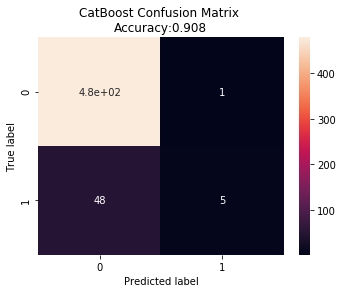

RMSE: 	 1.2573841004308852
r2: 	 0.17838205413479846
Accuracy: 	 0.9080675422138836
Recall: 	 0.09433962264150944
Precision: 	 0.8333333333333334
Specificity: 	 0.9979166666666667
NPV: 	 0.9089184060721063
F1: 		 0.16949152542372883


In [0]:
cat = model_pn('model', X_cat_train, y_cat_train, X_cat_test, y_cat_test, 'CatBoost')

CatBoost is still suffer from imbalanced data. Let's use sampling technology to remedy imbalanced data.

## 10.Over Sample Minority Class

### (1) Upsample for Data with categorical feature

In [0]:
def upsample_data_with_cat(X_train, y_train):
  # concatenate our training data back together
  data_cat_to_sample = pd.concat([X_train, y_train], axis=1)

  # separate minority and majority classes
  unhappy_cat = data_cat_to_sample[data_cat_to_sample['p_score'] < data_cat_to_sample['n_score']]
  happy_cat = data_cat_to_sample[data_cat_to_sample['p_score'] >= data_cat_to_sample['n_score']]


  # upsample minority
  unhappy_cat_upsampled = resample(unhappy_cat,
                            replace=True, # sample with replacement
                            n_samples=len(happy_cat), # match number in majority class
                            random_state=27) # reproducible results

  # combine majority and upsampled minority
  upsampled_cat = pd.concat([happy_cat, unhappy_cat_upsampled])

  # check new class counts
  print(upsampled_cat[upsampled_cat['p_score']>=upsampled_cat['n_score']].shape)
  print(upsampled_cat[upsampled_cat['p_score']<upsampled_cat['n_score']].shape)

  # Split train and test
  y_upsample_train = upsampled_cat[['p_score', 'n_score']]
  X_upsample_train = upsampled_cat.drop(['p_score', 'n_score'], axis=1)

  return X_upsample_train, y_upsample_train

X_cat_upsample_train, y_cat_upsample_train = upsample_data_with_cat(X_cat_train, y_cat_train)

(1419, 163)
(1419, 163)


### (2) Upsample Data for design matrix with one-hot encoding

In [0]:
def upsample_data_with_oh(X_train, y_train, X_test):
  # concatenate our training data back together
  data_to_sample = pd.concat([X_train, y_train], axis=1)

  # separate minority and majority classes
  unhappy = data_to_sample[data_to_sample['p_score'] < data_to_sample['n_score']]
  happy = data_to_sample[data_to_sample['p_score'] >= data_to_sample['n_score']]

  # upsample minority
  unhappy_upsampled = resample(unhappy,
                            replace=True, # sample with replacement
                            n_samples=len(happy), # match number in majority class
                            random_state=27) # reproducible results

  # combine majority and upsampled minority
  upsampled = pd.concat([happy, unhappy_upsampled])

  # check new class counts
  print(upsampled[upsampled['p_score'] < upsampled['n_score']].shape)
  print(upsampled[upsampled['p_score'] >= upsampled['n_score']].shape)

  # Split train and test
  y_upsample_train = upsampled[['p_score', 'n_score']]
  X_upsample_train = upsampled.drop(['p_score', 'n_score'], axis=1)

  # Scale for logistic regression
  scaler = preprocessing.StandardScaler().fit(X_upsample_train)
  X_upsample_train_scaled = scaler.transform(X_upsample_train)
  X_test_scaled = scaler.transform(X_test)

  return X_upsample_train_scaled, y_upsample_train, X_test_scaled

X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled = upsample_data_with_oh(X_oh_train, y_oh_train, X_oh_test)

(1419, 97)
(1419, 97)


### (3) Lasso Regression

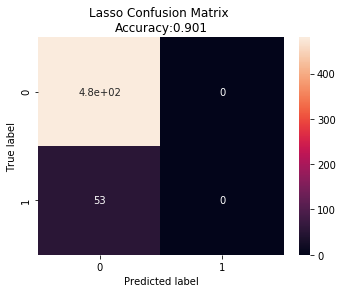

RMSE: 	 2.786550604342286
r2: 	 -0.8208278463236314
Accuracy: 	 0.900562851782364
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.900562851782364
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [0]:
ls = model_pn(Lasso(max_iter=20000), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'Lasso')

### (4) SVM

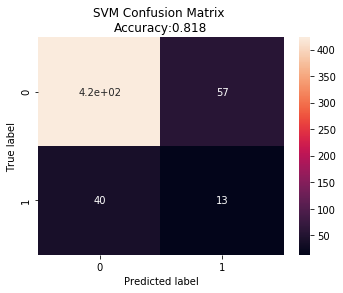

RMSE: 	 2.0297840094910153
r2: 	 -0.32633056824604734
Accuracy: 	 0.8180112570356473
Recall: 	 0.24528301886792453
Precision: 	 0.18571428571428572
Specificity: 	 0.88125
NPV: 	 0.9136069114470843
F1: 		 0.2113821138211382


In [0]:
svm_ = model_pn(svm.SVR(), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'SVM')

###(5) Bayesian Rdige

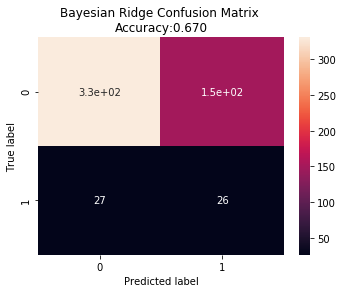

RMSE: 	 2.9867800512854226
r2: 	 -0.9516646422102417
Accuracy: 	 0.6697936210131332
Recall: 	 0.49056603773584906
Precision: 	 0.14857142857142858
Specificity: 	 0.6895833333333333
NPV: 	 0.9245810055865922
F1: 		 0.2280701754385965


In [0]:
br = model_pn(BayesianRidge(), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'Bayesian Ridge')

### (6) Random Forest

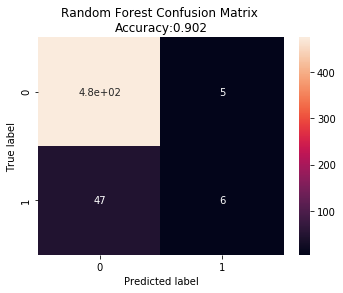

RMSE: 	 1.5470219095267874
r2: 	 -0.010877235586396194
Accuracy: 	 0.9024390243902439
Recall: 	 0.11320754716981132
Precision: 	 0.5454545454545454
Specificity: 	 0.9895833333333334
NPV: 	 0.9099616858237548
F1: 		 0.1875


In [0]:
rf = model_pn(RandomForestRegressor(), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'Random Forest')

### (7) CatBoost

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9276729	test: 1.1397239	best: 1.1397239 (0)	total: 74.7ms	remaining: 12m 27s
10:	learn: 0.9034678	test: 1.1163094	best: 1.1163094 (10)	total: 517ms	remaining: 7m 49s
20:	learn: 0.8834011	test: 1.1001231	best: 1.1001231 (20)	total: 860ms	remaining: 6m 48s
30:	learn: 0.8649978	test: 1.0826210	best: 1.0826210 (30)	total: 1.19s	remaining: 6m 23s
40:	learn: 0.8475750	test: 1.0675917	best: 1.0675917 (40)	total: 1.52s	remaining: 6m 9s
50:	learn: 0.8311326	test: 1.0502912	best: 1.0502912 (50)	total: 1.87s	remaining: 6m 5s
60:	learn: 0.8157475	test: 1.0371055	best: 1.0371055 (60)	total: 2.22s	remaining: 6m 1s
70:	learn: 0.8015711	test: 1.0291674	best: 1.0291674 (70)	total: 2.55s	remaining: 5m 57s
80:	learn: 0.7887078	test: 1.0204074	best: 1.0204074 (80)	total: 2.89s	remaining: 5m 53s
90:	learn: 0.7772234	test: 1.0139237	best: 1.0139237 (90)	total: 3.23s	remaining: 5m 51s
100:	learn: 0.7669765	test: 1.0053101	best: 1.0053101 (100)	total: 3.57s	remaining: 5m 49s
110:	learn: 0.7565238	

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7231047	test: 0.6960634	best: 0.6960634 (0)	total: 63.2ms	remaining: 10m 31s
10:	learn: 0.7036797	test: 0.6867296	best: 0.6867296 (10)	total: 468ms	remaining: 7m 4s
20:	learn: 0.6863852	test: 0.6782909	best: 0.6782909 (20)	total: 831ms	remaining: 6m 34s
30:	learn: 0.6709653	test: 0.6701579	best: 0.6701579 (30)	total: 1.17s	remaining: 6m 15s
40:	learn: 0.6570676	test: 0.6623280	best: 0.6623280 (40)	total: 1.5s	remaining: 6m 4s
50:	learn: 0.6434654	test: 0.6559067	best: 0.6559067 (50)	total: 1.83s	remaining: 5m 57s
60:	learn: 0.6312953	test: 0.6506831	best: 0.6506831 (60)	total: 2.17s	remaining: 5m 53s
70:	learn: 0.6192651	test: 0.6467470	best: 0.6464638 (69)	total: 2.51s	remaining: 5m 50s
80:	learn: 0.6081578	test: 0.6423635	best: 0.6423635 (80)	total: 2.84s	remaining: 5m 47s
90:	learn: 0.5985411	test: 0.6378699	best: 0.6378699 (90)	total: 3.18s	remaining: 5m 46s
100:	learn: 0.5890646	test: 0.6336686	best: 0.6336686 (100)	total: 3.51s	remaining: 5m 44s
110:	learn: 0.5805362	

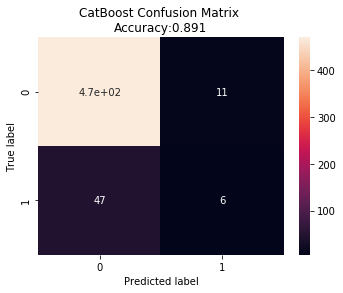

RMSE: 	 1.4212483874352826
r2: 	 0.07130750241819728
Accuracy: 	 0.8911819887429644
Recall: 	 0.11320754716981132
Precision: 	 0.35294117647058826
Specificity: 	 0.9770833333333333
NPV: 	 0.9089147286821705
F1: 		 0.17142857142857143


In [0]:
cat = model_pn(None, X_cat_upsample_train, y_cat_upsample_train, X_cat_test, y_cat_test, 'CatBoost')

### (8) Cross Validation

In [0]:
def model_eval(model, model_name, sample_type):
  if sample_type == 'up':
    X_cat_train = X_cat_upsample_train
    y_cat_train = y_cat_upsample_train
    X_oh_train = X_oh_upsample_train_scaled
    y_oh_train = y_oh_upsample_train
  elif sample_type == 'down':
    X_cat_train = X_cat_downsample_train
    y_cat_train = y_cat_downsample_train
    X_oh_train = X_oh_downsample_train_scaled
    y_oh_train = y_oh_downsample_train

  if model_name == 'CatBoost':
    return model_pn(None, X_cat_train, y_cat_train, X_cat_test, y_cat_test, 'CatBoost')
  else:
    return model_pn(model, X_oh_train, y_oh_train, X_oh_test_scaled, y_oh_test, model_name)

i. Cross validation for CatBoost, Stratified split

(1417, 163)
(1417, 163)


/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:296: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  FutureWarning
/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=4.
  % (min_groups, self.n_splits)), UserWarning)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9424373	test: 1.1336387	best: 1.1336387 (0)	total: 72.9ms	remaining: 12m 9s
10:	learn: 0.9150555	test: 1.1133032	best: 1.1133032 (10)	total: 481ms	remaining: 7m 17s
20:	learn: 0.8908345	test: 1.0934517	best: 1.0934517 (20)	total: 812ms	remaining: 6m 25s
30:	learn: 0.8683639	test: 1.0741093	best: 1.0741093 (30)	total: 1.14s	remaining: 6m 7s
40:	learn: 0.8479343	test: 1.0566858	best: 1.0566858 (40)	total: 1.46s	remaining: 5m 55s
50:	learn: 0.8293905	test: 1.0416464	best: 1.0416464 (50)	total: 1.79s	remaining: 5m 49s
60:	learn: 0.8136531	test: 1.0293359	best: 1.0293359 (60)	total: 2.14s	remaining: 5m 48s
70:	learn: 0.7978559	test: 1.0157709	best: 1.0157709 (70)	total: 2.47s	remaining: 5m 45s
80:	learn: 0.7847506	test: 1.0044452	best: 1.0044452 (80)	total: 2.81s	remaining: 5m 44s
90:	learn: 0.7714794	test: 0.9945830	best: 0.9945830 (90)	total: 3.17s	remaining: 5m 45s
100:	learn: 0.7609031	test: 0.9862260	best: 0.9862260 (100)	total: 3.5s	remaining: 5m 43s
110:	learn: 0.7503638	

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7667707	test: 0.7093271	best: 0.7093271 (0)	total: 64.4ms	remaining: 10m 44s
10:	learn: 0.7426503	test: 0.6951011	best: 0.6951011 (10)	total: 441ms	remaining: 6m 40s
20:	learn: 0.7212376	test: 0.6821578	best: 0.6821578 (20)	total: 770ms	remaining: 6m 5s
30:	learn: 0.7011190	test: 0.6707235	best: 0.6707235 (30)	total: 1.11s	remaining: 5m 56s
40:	learn: 0.6825882	test: 0.6611361	best: 0.6611361 (40)	total: 1.5s	remaining: 6m 4s
50:	learn: 0.6658238	test: 0.6526102	best: 0.6526102 (50)	total: 1.84s	remaining: 5m 58s
60:	learn: 0.6515762	test: 0.6454651	best: 0.6454651 (60)	total: 2.18s	remaining: 5m 55s
70:	learn: 0.6385247	test: 0.6389987	best: 0.6389987 (70)	total: 2.51s	remaining: 5m 51s
80:	learn: 0.6265688	test: 0.6339342	best: 0.6339342 (80)	total: 2.84s	remaining: 5m 48s
90:	learn: 0.6150586	test: 0.6280295	best: 0.6280295 (90)	total: 3.19s	remaining: 5m 46s
100:	learn: 0.6044133	test: 0.6226083	best: 0.6226083 (100)	total: 3.52s	remaining: 5m 44s
110:	learn: 0.5935737	

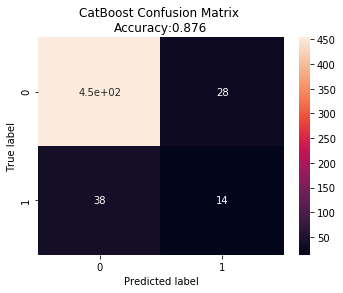

RMSE: 	 1.2187023426319377
r2: 	 0.12989896930969735
Accuracy: 	 0.8764044943820225
Recall: 	 0.2692307692307692
Precision: 	 0.3333333333333333
Specificity: 	 0.941908713692946
NPV: 	 0.9227642276422764
F1: 		 0.2978723404255319
(1420, 163)
(1420, 163)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9407523	test: 1.0421721	best: 1.0421721 (0)	total: 68.7ms	remaining: 11m 26s
10:	learn: 0.9138356	test: 1.0180742	best: 1.0180742 (10)	total: 461ms	remaining: 6m 58s
20:	learn: 0.8898549	test: 0.9966099	best: 0.9966099 (20)	total: 794ms	remaining: 6m 17s
30:	learn: 0.8677019	test: 0.9764475	best: 0.9764475 (30)	total: 1.14s	remaining: 6m 5s
40:	learn: 0.8480174	test: 0.9589993	best: 0.9589993 (40)	total: 1.47s	remaining: 5m 56s
50:	learn: 0.8295939	test: 0.9427455	best: 0.9427455 (50)	total: 1.8s	remaining: 5m 50s
60:	learn: 0.8125278	test: 0.9273604	best: 0.9273604 (60)	total: 2.13s	remaining: 5m 47s
70:	learn: 0.7978301	test: 0.9153154	best: 0.9153154 (70)	total: 2.47s	remaining: 5m 45s
80:	learn: 0.7837762	test: 0.9038452	best: 0.9038452 (80)	total: 2.81s	remaining: 5m 43s
90:	learn: 0.7705947	test: 0.8929706	best: 0.8929706 (90)	total: 3.15s	remaining: 5m 42s
100:	learn: 0.7591576	test: 0.8847779	best: 0.8847779 (100)	total: 3.48s	remaining: 5m 40s
110:	learn: 0.7473287

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7612898	test: 0.6964369	best: 0.6964369 (0)	total: 136ms	remaining: 22m 35s
10:	learn: 0.7404458	test: 0.6804510	best: 0.6804510 (10)	total: 546ms	remaining: 8m 16s
20:	learn: 0.7220591	test: 0.6669689	best: 0.6669689 (20)	total: 886ms	remaining: 7m
30:	learn: 0.7041636	test: 0.6541535	best: 0.6541535 (30)	total: 1.21s	remaining: 6m 30s
40:	learn: 0.6880644	test: 0.6423650	best: 0.6423650 (40)	total: 1.54s	remaining: 6m 14s
50:	learn: 0.6743669	test: 0.6321647	best: 0.6321647 (50)	total: 1.88s	remaining: 6m 6s
60:	learn: 0.6607299	test: 0.6225226	best: 0.6225226 (60)	total: 2.21s	remaining: 6m
70:	learn: 0.6471889	test: 0.6132462	best: 0.6132462 (70)	total: 2.54s	remaining: 5m 55s
80:	learn: 0.6349991	test: 0.6048563	best: 0.6048563 (80)	total: 2.89s	remaining: 5m 53s
90:	learn: 0.6239341	test: 0.5972615	best: 0.5972615 (90)	total: 3.22s	remaining: 5m 51s
100:	learn: 0.6130522	test: 0.5906765	best: 0.5906765 (100)	total: 3.57s	remaining: 5m 49s
110:	learn: 0.6035049	test: 0

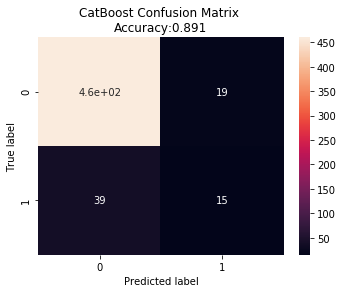

RMSE: 	 1.128936941446919
r2: 	 0.195513021095992
Accuracy: 	 0.8911819887429644
Recall: 	 0.2777777777777778
Precision: 	 0.4411764705882353
Specificity: 	 0.9603340292275574
NPV: 	 0.9218436873747495
F1: 		 0.34090909090909094
(1428, 163)
(1428, 163)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9686096	test: 0.9174238	best: 0.9174238 (0)	total: 94.6ms	remaining: 15m 45s
10:	learn: 0.9418107	test: 0.8920302	best: 0.8920302 (10)	total: 457ms	remaining: 6m 54s
20:	learn: 0.9167238	test: 0.8689181	best: 0.8689181 (20)	total: 822ms	remaining: 6m 30s
30:	learn: 0.8948061	test: 0.8483361	best: 0.8483361 (30)	total: 1.16s	remaining: 6m 13s
40:	learn: 0.8749546	test: 0.8308996	best: 0.8308996 (40)	total: 1.5s	remaining: 6m 3s
50:	learn: 0.8573104	test: 0.8166247	best: 0.8166247 (50)	total: 1.83s	remaining: 5m 56s
60:	learn: 0.8422007	test: 0.8047084	best: 0.8047084 (60)	total: 2.17s	remaining: 5m 53s
70:	learn: 0.8270480	test: 0.7926232	best: 0.7926232 (70)	total: 2.51s	remaining: 5m 50s
80:	learn: 0.8136875	test: 0.7833901	best: 0.7833901 (80)	total: 2.84s	remaining: 5m 47s
90:	learn: 0.8010309	test: 0.7750738	best: 0.7750738 (90)	total: 3.18s	remaining: 5m 46s
100:	learn: 0.7888098	test: 0.7671011	best: 0.7671011 (100)	total: 3.52s	remaining: 5m 45s
110:	learn: 0.7776799

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7725999	test: 0.7105838	best: 0.7105838 (0)	total: 57.1ms	remaining: 9m 30s
10:	learn: 0.7510444	test: 0.6934918	best: 0.6934918 (10)	total: 409ms	remaining: 6m 11s
20:	learn: 0.7316268	test: 0.6786667	best: 0.6786667 (20)	total: 777ms	remaining: 6m 9s
30:	learn: 0.7133868	test: 0.6653446	best: 0.6653446 (30)	total: 1.11s	remaining: 5m 57s
40:	learn: 0.6969566	test: 0.6535627	best: 0.6535627 (40)	total: 1.44s	remaining: 5m 50s
50:	learn: 0.6820810	test: 0.6427896	best: 0.6427896 (50)	total: 1.77s	remaining: 5m 45s
60:	learn: 0.6680594	test: 0.6329307	best: 0.6329307 (60)	total: 2.11s	remaining: 5m 43s
70:	learn: 0.6547632	test: 0.6237263	best: 0.6237263 (70)	total: 2.44s	remaining: 5m 40s
80:	learn: 0.6428088	test: 0.6162353	best: 0.6162353 (80)	total: 2.77s	remaining: 5m 39s
90:	learn: 0.6317060	test: 0.6094800	best: 0.6094800 (90)	total: 3.11s	remaining: 5m 38s
100:	learn: 0.6217809	test: 0.6039446	best: 0.6039446 (100)	total: 3.44s	remaining: 5m 37s
110:	learn: 0.6118465

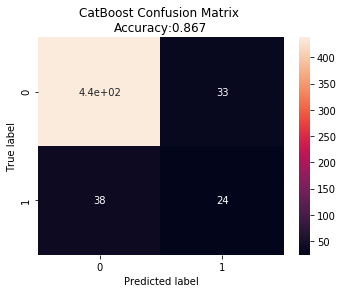

RMSE: 	 1.0203129019520516
r2: 	 0.23154097073495905
Accuracy: 	 0.8667917448405253
Recall: 	 0.3870967741935484
Precision: 	 0.42105263157894735
Specificity: 	 0.9299363057324841
NPV: 	 0.9201680672268907
F1: 		 0.4033613445378151
(1432, 163)
(1432, 163)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9437921	test: 0.9613518	best: 0.9613518 (0)	total: 69.2ms	remaining: 11m 31s
10:	learn: 0.9177524	test: 0.9378933	best: 0.9378933 (10)	total: 486ms	remaining: 7m 21s
20:	learn: 0.8951064	test: 0.9185291	best: 0.9185291 (20)	total: 819ms	remaining: 6m 29s
30:	learn: 0.8743466	test: 0.8999256	best: 0.8999256 (30)	total: 1.15s	remaining: 6m 11s
40:	learn: 0.8549479	test: 0.8836118	best: 0.8836118 (40)	total: 1.49s	remaining: 6m 2s
50:	learn: 0.8363423	test: 0.8681801	best: 0.8681801 (50)	total: 1.83s	remaining: 5m 56s
60:	learn: 0.8193775	test: 0.8545132	best: 0.8545132 (60)	total: 2.18s	remaining: 5m 55s
70:	learn: 0.8039915	test: 0.8425698	best: 0.8425698 (70)	total: 2.52s	remaining: 5m 53s
80:	learn: 0.7913834	test: 0.8337691	best: 0.8337691 (80)	total: 2.86s	remaining: 5m 50s
90:	learn: 0.7788104	test: 0.8243399	best: 0.8243399 (90)	total: 3.21s	remaining: 5m 49s
100:	learn: 0.7672716	test: 0.8163052	best: 0.8163052 (100)	total: 3.55s	remaining: 5m 47s
110:	learn: 0.756979

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7687312	test: 0.7069456	best: 0.7069456 (0)	total: 112ms	remaining: 18m 38s
10:	learn: 0.7482206	test: 0.6916056	best: 0.6916056 (10)	total: 478ms	remaining: 7m 14s
20:	learn: 0.7293595	test: 0.6775608	best: 0.6775608 (20)	total: 809ms	remaining: 6m 24s
30:	learn: 0.7123997	test: 0.6654183	best: 0.6654183 (30)	total: 1.15s	remaining: 6m 9s
40:	learn: 0.6962366	test: 0.6543992	best: 0.6543992 (40)	total: 1.48s	remaining: 5m 58s
50:	learn: 0.6816518	test: 0.6451873	best: 0.6451873 (50)	total: 1.81s	remaining: 5m 52s
60:	learn: 0.6681396	test: 0.6368907	best: 0.6368907 (60)	total: 2.17s	remaining: 5m 53s
70:	learn: 0.6559506	test: 0.6294603	best: 0.6294603 (70)	total: 2.5s	remaining: 5m 50s
80:	learn: 0.6450471	test: 0.6224796	best: 0.6224796 (80)	total: 2.85s	remaining: 5m 48s
90:	learn: 0.6344528	test: 0.6157654	best: 0.6157654 (90)	total: 3.19s	remaining: 5m 47s
100:	learn: 0.6245737	test: 0.6103228	best: 0.6103228 (100)	total: 3.53s	remaining: 5m 46s
110:	learn: 0.6146913	

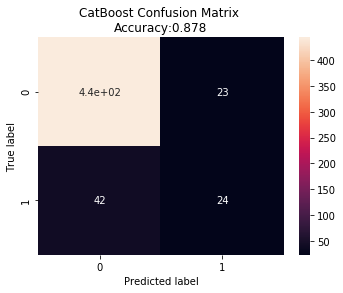

RMSE: 	 1.0599800915000277
r2: 	 0.27303521525019747
Accuracy: 	 0.8780487804878049
Recall: 	 0.36363636363636365
Precision: 	 0.5106382978723404
Specificity: 	 0.9507494646680942
NPV: 	 0.9135802469135802
F1: 		 0.4247787610619469


In [0]:
cat_upsample_result = []
skf = StratifiedKFold(n_splits=4, random_state=27, shuffle=False)
for train_index, test_index in skf.split(X_cat, group_cat):
  # Stratified Split
  X_cat_train, X_cat_test = X_cat.iloc[train_index], X_cat.iloc[test_index]
  y_cat_train, y_cat_test = y_cat.iloc[train_index], y_cat.iloc[test_index]
  # Up sample
  X_cat_upsample_train, y_cat_upsample_train = upsample_data_with_cat(X_cat_train, y_cat_train)
  # CatBoost
  cat_res = model_pn(None, X_cat_upsample_train, y_cat_upsample_train, X_cat_test, y_cat_test, 'CatBoost')
  cat_upsample_result.append(cat_res)

ii. Cross validation for Lasso, SVM, Bayesian Ridge RandomForest with Stratified split

(1417, 97)
(1417, 97)


/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:296: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  FutureWarning
/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=4.
  % (min_groups, self.n_splits)), UserWarning)


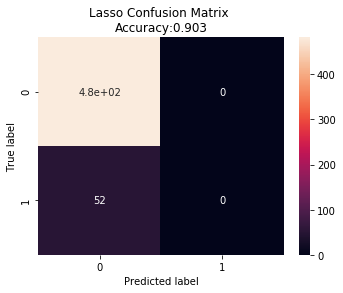

RMSE: 	 2.9317836957331966
r2: 	 -1.093167401245322
Accuracy: 	 0.9026217228464419
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.9026217228464419
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


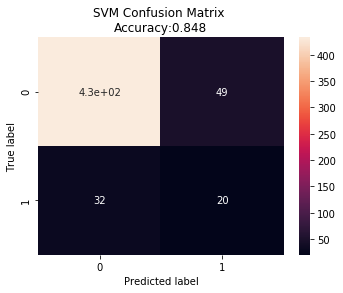

RMSE: 	 1.57154176956656
r2: 	 -0.1220131984973929
Accuracy: 	 0.848314606741573
Recall: 	 0.38461538461538464
Precision: 	 0.2898550724637681
Specificity: 	 0.8983402489626556
NPV: 	 0.9311827956989247
F1: 		 0.3305785123966942


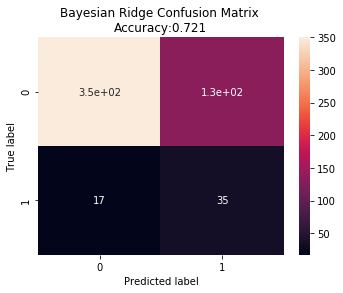

RMSE: 	 2.5779819921205473
r2: 	 -0.8405682092978235
Accuracy: 	 0.7209737827715356
Recall: 	 0.6730769230769231
Precision: 	 0.20958083832335328
Specificity: 	 0.7261410788381742
NPV: 	 0.9536784741144414
F1: 		 0.31963470319634707


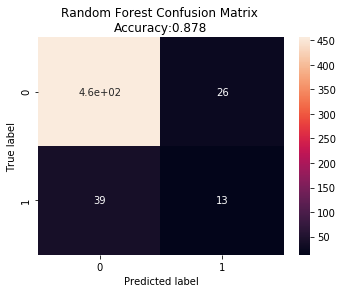

RMSE: 	 1.3336669163545567
r2: 	 0.0478192107093377
Accuracy: 	 0.8782771535580525
Recall: 	 0.25
Precision: 	 0.3333333333333333
Specificity: 	 0.946058091286307
NPV: 	 0.9212121212121213
F1: 		 0.28571428571428575
(1420, 97)
(1420, 97)


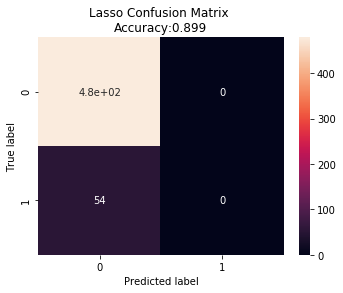

RMSE: 	 2.4898044756418254
r2: 	 -0.7742490365348265
Accuracy: 	 0.8986866791744841
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.8986866791744841
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


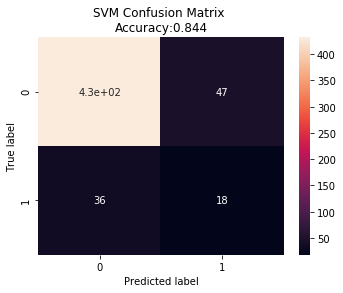

RMSE: 	 1.3840817491117121
r2: 	 0.013695358863929585
Accuracy: 	 0.8442776735459663
Recall: 	 0.3333333333333333
Precision: 	 0.27692307692307694
Specificity: 	 0.9018789144050104
NPV: 	 0.9230769230769231
F1: 		 0.3025210084033613


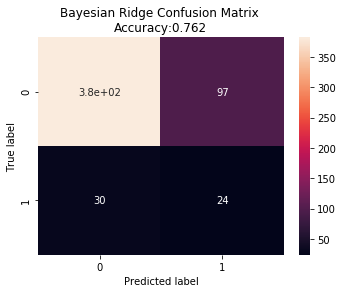

RMSE: 	 1.9249345105648124
r2: 	 -0.37171943988969325
Accuracy: 	 0.7617260787992496
Recall: 	 0.4444444444444444
Precision: 	 0.19834710743801653
Specificity: 	 0.7974947807933194
NPV: 	 0.9271844660194175
F1: 		 0.2742857142857143


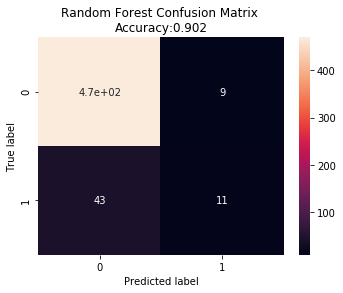

RMSE: 	 1.0810601417552639
r2: 	 0.22963030482502567
Accuracy: 	 0.9024390243902439
Recall: 	 0.2037037037037037
Precision: 	 0.55
Specificity: 	 0.9812108559498957
NPV: 	 0.9161793372319688
F1: 		 0.2972972972972973
(1428, 97)
(1428, 97)


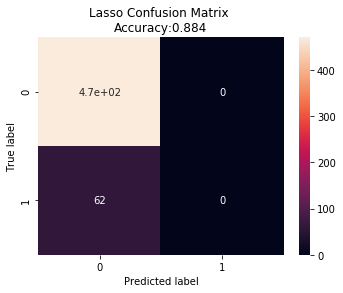

RMSE: 	 2.1747447383798044
r2: 	 -0.637931096781462
Accuracy: 	 0.8836772983114447
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.8836772983114447
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


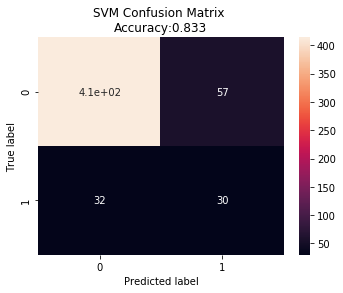

RMSE: 	 1.3387765213754172
r2: 	 -0.00831314006781847
Accuracy: 	 0.8330206378986866
Recall: 	 0.4838709677419355
Precision: 	 0.3448275862068966
Specificity: 	 0.8789808917197452
NPV: 	 0.9282511210762332
F1: 		 0.4026845637583893


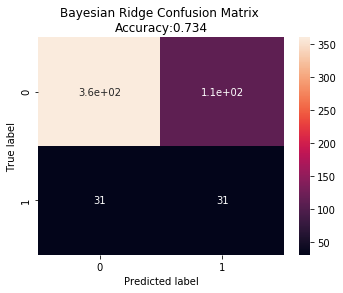

RMSE: 	 1.780522101788943
r2: 	 -0.3410183124293975
Accuracy: 	 0.7335834896810507
Recall: 	 0.5
Precision: 	 0.21830985915492956
Specificity: 	 0.7643312101910829
NPV: 	 0.9207161125319693
F1: 		 0.303921568627451


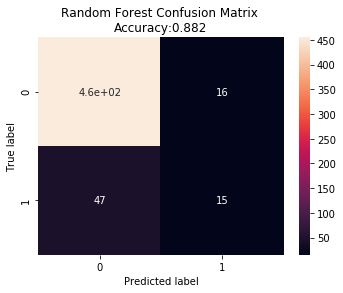

RMSE: 	 0.9382259328747133
r2: 	 0.2933656055619772
Accuracy: 	 0.8818011257035647
Recall: 	 0.24193548387096775
Precision: 	 0.4838709677419355
Specificity: 	 0.9660297239915074
NPV: 	 0.9063745019920318
F1: 		 0.32258064516129037
(1432, 97)
(1432, 97)


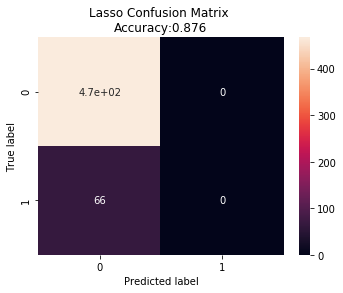

RMSE: 	 2.276768789460179
r2: 	 -0.5614734146683209
Accuracy: 	 0.8761726078799249
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.8761726078799249
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


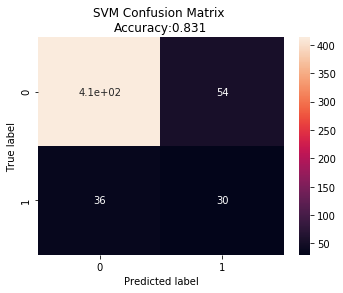

RMSE: 	 1.4243287671662086
r2: 	 0.023154430975548812
Accuracy: 	 0.8311444652908068
Recall: 	 0.45454545454545453
Precision: 	 0.35714285714285715
Specificity: 	 0.8843683083511777
NPV: 	 0.9198218262806236
F1: 		 0.4


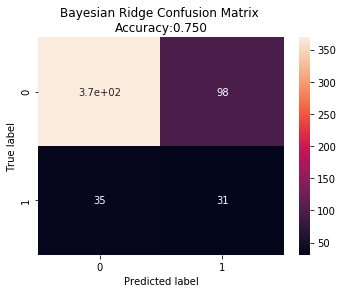

RMSE: 	 1.8990571233547444
r2: 	 -0.3024279078237053
Accuracy: 	 0.7504690431519699
Recall: 	 0.4696969696969697
Precision: 	 0.24031007751937986
Specificity: 	 0.7901498929336188
NPV: 	 0.9133663366336634
F1: 		 0.317948717948718


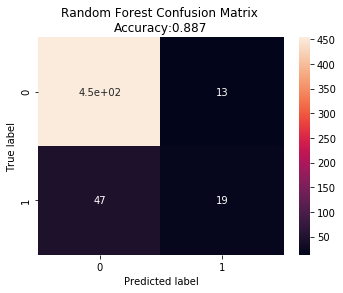

RMSE: 	 1.0795414634146343
r2: 	 0.25961946467398733
Accuracy: 	 0.8874296435272045
Recall: 	 0.2878787878787879
Precision: 	 0.59375
Specificity: 	 0.9721627408993576
NPV: 	 0.906187624750499
F1: 		 0.38775510204081637


In [0]:
ls_upsample_result = []
svm_upsample_result = []
br_upsample_result = []
rf_upsample_result = []

skf = StratifiedKFold(n_splits=4, random_state=27, shuffle=False)
for train_index, test_index in skf.split(X_oh, group_oh):
  # Stratified Split
  X_oh_train, X_oh_test = X_oh.iloc[train_index], X_oh.iloc[test_index]
  y_oh_train, y_oh_test = y_oh.iloc[train_index], y_oh.iloc[test_index]
  # Up sample
  X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled = upsample_data_with_oh(X_oh_train, y_oh_train, X_oh_test)
  # Lasso
  ls_res = model_pn(Lasso(max_iter=20000), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'Lasso')
  ls_upsample_result.append(ls_res)
  # SVM
  svm_res = model_pn(svm.SVR(), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'SVM')
  svm_upsample_result.append(svm_res)
  # Bayesian Ridge
  br_res = model_pn(BayesianRidge(), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'Bayesian Ridge')
  br_upsample_result.append(br_res)
  # Random Forest
  rf_res = model_pn(RandomForestRegressor(), X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled, y_oh_test, 'Random Forest')
  rf_upsample_result.append(rf_res)

iii. Cross validation with random split

(1414, 97)
(1414, 97)
(1419, 163)
(1419, 163)


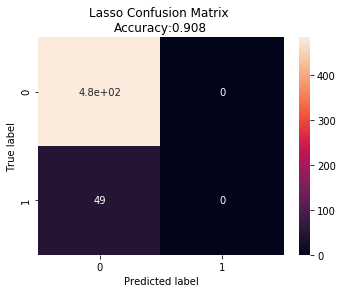

RMSE: 	 2.207431237450522
r2: 	 -0.8952704079610379
Accuracy: 	 0.9082397003745318
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.9082397003745318
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


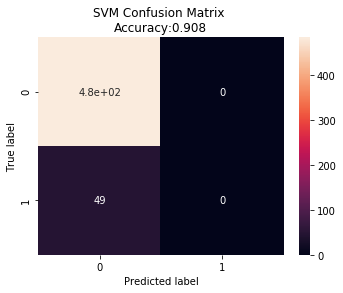

RMSE: 	 1.3398668552681092
r2: 	 -0.1503914406549578
Accuracy: 	 0.9082397003745318
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.9082397003745318
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


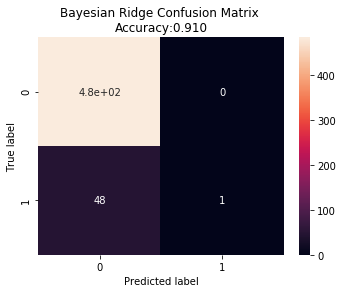

RMSE: 	 1.6691784518194606
r2: 	 -0.4331338941245506
Accuracy: 	 0.9101123595505618
Recall: 	 0.02040816326530612
Precision: 	 1.0
Specificity: 	 1.0
NPV: 	 0.9099437148217636
F1: 		 0.039999999999999994


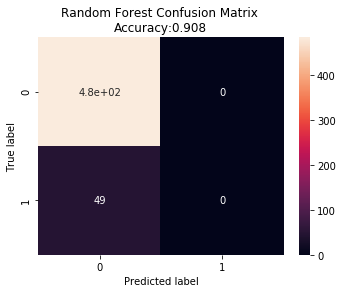

RMSE: 	 1.4564113607990017
r2: 	 -0.2504549664381035
Accuracy: 	 0.9082397003745318
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.9082397003745318
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9276729	test: 1.1397239	best: 1.1397239 (0)	total: 63.6ms	remaining: 10m 36s
10:	learn: 0.9034678	test: 1.1163094	best: 1.1163094 (10)	total: 468ms	remaining: 7m 4s
20:	learn: 0.8834011	test: 1.1001231	best: 1.1001231 (20)	total: 801ms	remaining: 6m 20s
30:	learn: 0.8649978	test: 1.0826210	best: 1.0826210 (30)	total: 1.14s	remaining: 6m 6s
40:	learn: 0.8475750	test: 1.0675917	best: 1.0675917 (40)	total: 1.47s	remaining: 5m 58s
50:	learn: 0.8311326	test: 1.0502912	best: 1.0502912 (50)	total: 1.81s	remaining: 5m 52s
60:	learn: 0.8157475	test: 1.0371055	best: 1.0371055 (60)	total: 2.15s	remaining: 5m 49s
70:	learn: 0.8015711	test: 1.0291674	best: 1.0291674 (70)	total: 2.48s	remaining: 5m 46s
80:	learn: 0.7887078	test: 1.0204074	best: 1.0204074 (80)	total: 2.81s	remaining: 5m 44s
90:	learn: 0.7772234	test: 1.0139237	best: 1.0139237 (90)	total: 3.19s	remaining: 5m 47s
100:	learn: 0.7669765	test: 1.0053101	best: 1.0053101 (100)	total: 3.52s	remaining: 5m 44s
110:	learn: 0.7565238

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7231047	test: 0.6960634	best: 0.6960634 (0)	total: 49.1ms	remaining: 8m 11s
10:	learn: 0.7036797	test: 0.6867296	best: 0.6867296 (10)	total: 541ms	remaining: 8m 11s
20:	learn: 0.6863852	test: 0.6782909	best: 0.6782909 (20)	total: 872ms	remaining: 6m 54s
30:	learn: 0.6709653	test: 0.6701579	best: 0.6701579 (30)	total: 1.21s	remaining: 6m 27s
40:	learn: 0.6570676	test: 0.6623280	best: 0.6623280 (40)	total: 1.53s	remaining: 6m 12s
50:	learn: 0.6434654	test: 0.6559067	best: 0.6559067 (50)	total: 1.86s	remaining: 6m 3s
60:	learn: 0.6312953	test: 0.6506831	best: 0.6506831 (60)	total: 2.21s	remaining: 6m
70:	learn: 0.6192651	test: 0.6467470	best: 0.6464638 (69)	total: 2.54s	remaining: 5m 54s
80:	learn: 0.6081578	test: 0.6423635	best: 0.6423635 (80)	total: 2.87s	remaining: 5m 50s
90:	learn: 0.5985411	test: 0.6378699	best: 0.6378699 (90)	total: 3.24s	remaining: 5m 52s
100:	learn: 0.5890646	test: 0.6336686	best: 0.6336686 (100)	total: 3.57s	remaining: 5m 49s
110:	learn: 0.5805362	tes

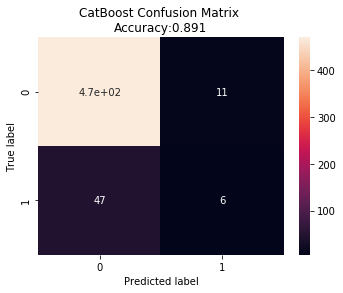

RMSE: 	 1.4212483874352826
r2: 	 0.07130750241819728
Accuracy: 	 0.8911819887429644
Recall: 	 0.11320754716981132
Precision: 	 0.35294117647058826
Specificity: 	 0.9770833333333333
NPV: 	 0.9089147286821705
F1: 		 0.17142857142857143
(1419, 97)
(1419, 97)
(1419, 163)
(1419, 163)


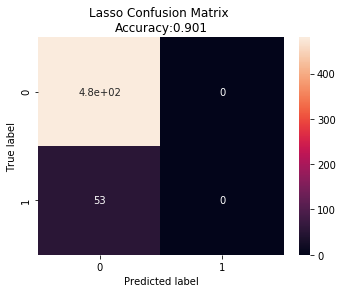

RMSE: 	 2.786550604342286
r2: 	 -0.8208278463236314
Accuracy: 	 0.900562851782364
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.900562851782364
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


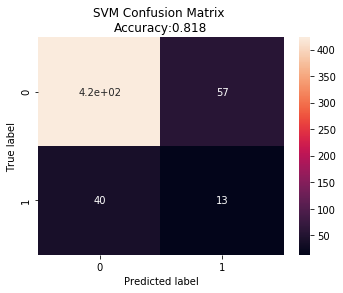

RMSE: 	 2.0297840094910153
r2: 	 -0.32633056824604734
Accuracy: 	 0.8180112570356473
Recall: 	 0.24528301886792453
Precision: 	 0.18571428571428572
Specificity: 	 0.88125
NPV: 	 0.9136069114470843
F1: 		 0.2113821138211382


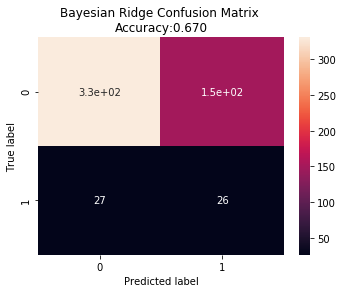

RMSE: 	 2.9867800512854226
r2: 	 -0.9516646422102417
Accuracy: 	 0.6697936210131332
Recall: 	 0.49056603773584906
Precision: 	 0.14857142857142858
Specificity: 	 0.6895833333333333
NPV: 	 0.9245810055865922
F1: 		 0.2280701754385965


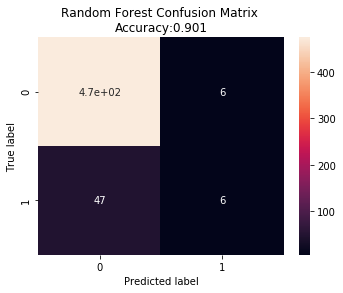

RMSE: 	 1.5653744006670836
r2: 	 -0.022869383464703352
Accuracy: 	 0.900562851782364
Recall: 	 0.11320754716981132
Precision: 	 0.5
Specificity: 	 0.9875
NPV: 	 0.9097888675623801
F1: 		 0.18461538461538463


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9276729	test: 1.1397239	best: 1.1397239 (0)	total: 84.2ms	remaining: 14m 2s
10:	learn: 0.9034678	test: 1.1163094	best: 1.1163094 (10)	total: 476ms	remaining: 7m 12s
20:	learn: 0.8834011	test: 1.1001231	best: 1.1001231 (20)	total: 810ms	remaining: 6m 24s
30:	learn: 0.8649978	test: 1.0826210	best: 1.0826210 (30)	total: 1.15s	remaining: 6m 8s
40:	learn: 0.8475750	test: 1.0675917	best: 1.0675917 (40)	total: 1.48s	remaining: 5m 58s
50:	learn: 0.8311326	test: 1.0502912	best: 1.0502912 (50)	total: 1.81s	remaining: 5m 53s
60:	learn: 0.8157475	test: 1.0371055	best: 1.0371055 (60)	total: 2.15s	remaining: 5m 50s
70:	learn: 0.8015711	test: 1.0291674	best: 1.0291674 (70)	total: 2.48s	remaining: 5m 47s
80:	learn: 0.7887078	test: 1.0204074	best: 1.0204074 (80)	total: 2.81s	remaining: 5m 44s
90:	learn: 0.7772234	test: 1.0139237	best: 1.0139237 (90)	total: 3.17s	remaining: 5m 45s
100:	learn: 0.7669765	test: 1.0053101	best: 1.0053101 (100)	total: 3.5s	remaining: 5m 42s
110:	learn: 0.7565238	

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7231047	test: 0.6960634	best: 0.6960634 (0)	total: 122ms	remaining: 20m 19s
10:	learn: 0.7036797	test: 0.6867296	best: 0.6867296 (10)	total: 576ms	remaining: 8m 43s
20:	learn: 0.6863852	test: 0.6782909	best: 0.6782909 (20)	total: 915ms	remaining: 7m 14s
30:	learn: 0.6709653	test: 0.6701579	best: 0.6701579 (30)	total: 1.24s	remaining: 6m 39s
40:	learn: 0.6570676	test: 0.6623280	best: 0.6623280 (40)	total: 1.57s	remaining: 6m 22s
50:	learn: 0.6434654	test: 0.6559067	best: 0.6559067 (50)	total: 1.9s	remaining: 6m 10s
60:	learn: 0.6312953	test: 0.6506831	best: 0.6506831 (60)	total: 2.24s	remaining: 6m 5s
70:	learn: 0.6192651	test: 0.6467470	best: 0.6464638 (69)	total: 2.57s	remaining: 5m 59s
80:	learn: 0.6081578	test: 0.6423635	best: 0.6423635 (80)	total: 2.9s	remaining: 5m 55s
90:	learn: 0.5985411	test: 0.6378699	best: 0.6378699 (90)	total: 3.25s	remaining: 5m 53s
100:	learn: 0.5890646	test: 0.6336686	best: 0.6336686 (100)	total: 3.58s	remaining: 5m 51s
110:	learn: 0.5805362	t

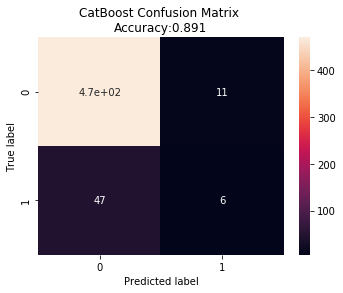

RMSE: 	 1.4212483874352826
r2: 	 0.07130750241819728
Accuracy: 	 0.8911819887429644
Recall: 	 0.11320754716981132
Precision: 	 0.35294117647058826
Specificity: 	 0.9770833333333333
NPV: 	 0.9089147286821705
F1: 		 0.17142857142857143
(1435, 97)
(1435, 97)
(1419, 163)
(1419, 163)


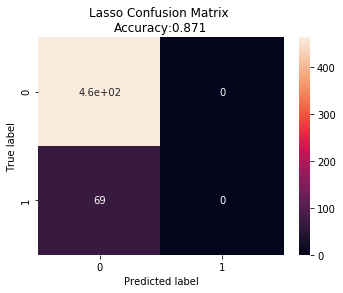

RMSE: 	 2.0901286435347792
r2: 	 -0.503965327438638
Accuracy: 	 0.8705440900562852
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.8705440900562852
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


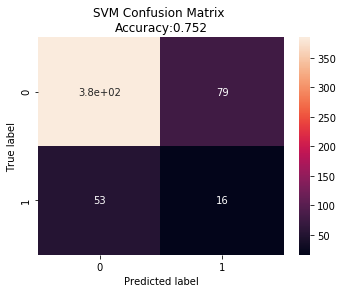

RMSE: 	 2.1701061384666755
r2: 	 -0.561513641378564
Accuracy: 	 0.7523452157598499
Recall: 	 0.2318840579710145
Precision: 	 0.16842105263157894
Specificity: 	 0.8297413793103449
NPV: 	 0.8789954337899544
F1: 		 0.1951219512195122


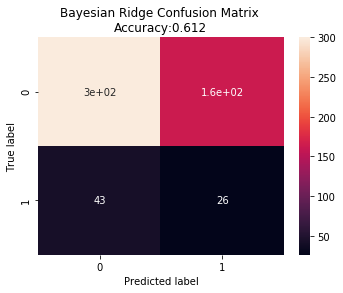

RMSE: 	 3.348703371831564
r2: 	 -1.409580758911659
Accuracy: 	 0.6116322701688556
Recall: 	 0.37681159420289856
Precision: 	 0.1368421052631579
Specificity: 	 0.646551724137931
NPV: 	 0.8746355685131195
F1: 		 0.2007722007722008


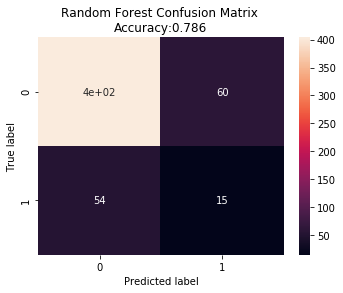

RMSE: 	 1.9239177611006886
r2: 	 -0.38436723236583936
Accuracy: 	 0.7861163227016885
Recall: 	 0.21739130434782608
Precision: 	 0.2
Specificity: 	 0.8706896551724138
NPV: 	 0.8820960698689956
F1: 		 0.20833333333333331


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9276729	test: 1.1397239	best: 1.1397239 (0)	total: 88.6ms	remaining: 14m 45s
10:	learn: 0.9034678	test: 1.1163094	best: 1.1163094 (10)	total: 486ms	remaining: 7m 21s
20:	learn: 0.8834011	test: 1.1001231	best: 1.1001231 (20)	total: 812ms	remaining: 6m 25s
30:	learn: 0.8649978	test: 1.0826210	best: 1.0826210 (30)	total: 1.14s	remaining: 6m 8s
40:	learn: 0.8475750	test: 1.0675917	best: 1.0675917 (40)	total: 1.47s	remaining: 5m 58s
50:	learn: 0.8311326	test: 1.0502912	best: 1.0502912 (50)	total: 1.81s	remaining: 5m 53s
60:	learn: 0.8157475	test: 1.0371055	best: 1.0371055 (60)	total: 2.16s	remaining: 5m 52s
70:	learn: 0.8015711	test: 1.0291674	best: 1.0291674 (70)	total: 2.49s	remaining: 5m 48s
80:	learn: 0.7887078	test: 1.0204074	best: 1.0204074 (80)	total: 2.82s	remaining: 5m 45s
90:	learn: 0.7772234	test: 1.0139237	best: 1.0139237 (90)	total: 3.17s	remaining: 5m 45s
100:	learn: 0.7669765	test: 1.0053101	best: 1.0053101 (100)	total: 3.5s	remaining: 5m 43s
110:	learn: 0.7565238

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7231047	test: 0.6960634	best: 0.6960634 (0)	total: 77.1ms	remaining: 12m 51s
10:	learn: 0.7036797	test: 0.6867296	best: 0.6867296 (10)	total: 441ms	remaining: 6m 40s
20:	learn: 0.6863852	test: 0.6782909	best: 0.6782909 (20)	total: 767ms	remaining: 6m 4s
30:	learn: 0.6709653	test: 0.6701579	best: 0.6701579 (30)	total: 1.17s	remaining: 6m 16s
40:	learn: 0.6570676	test: 0.6623280	best: 0.6623280 (40)	total: 1.5s	remaining: 6m 4s
50:	learn: 0.6434654	test: 0.6559067	best: 0.6559067 (50)	total: 1.83s	remaining: 5m 56s
60:	learn: 0.6312953	test: 0.6506831	best: 0.6506831 (60)	total: 2.17s	remaining: 5m 52s
70:	learn: 0.6192651	test: 0.6467470	best: 0.6464638 (69)	total: 2.5s	remaining: 5m 49s
80:	learn: 0.6081578	test: 0.6423635	best: 0.6423635 (80)	total: 2.82s	remaining: 5m 45s
90:	learn: 0.5985411	test: 0.6378699	best: 0.6378699 (90)	total: 3.16s	remaining: 5m 44s
100:	learn: 0.5890646	test: 0.6336686	best: 0.6336686 (100)	total: 3.48s	remaining: 5m 40s
110:	learn: 0.5805362	t

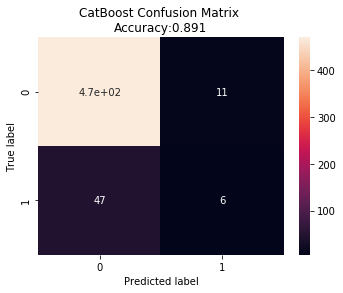

RMSE: 	 1.4212483874352826
r2: 	 0.07130750241819728
Accuracy: 	 0.8911819887429644
Recall: 	 0.11320754716981132
Precision: 	 0.35294117647058826
Specificity: 	 0.9770833333333333
NPV: 	 0.9089147286821705
F1: 		 0.17142857142857143
(1429, 97)
(1429, 97)
(1419, 163)
(1419, 163)


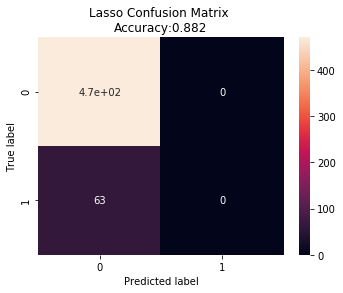

RMSE: 	 2.738141321576607
r2: 	 -0.8118497816862651
Accuracy: 	 0.8818011257035647
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 1.0
NPV: 	 0.8818011257035647
F1: 		 0.0


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


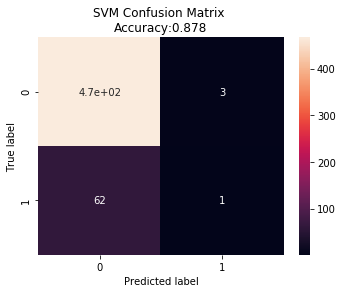

RMSE: 	 1.7047372859436576
r2: 	 -0.12803815311876554
Accuracy: 	 0.8780487804878049
Recall: 	 0.015873015873015872
Precision: 	 0.25
Specificity: 	 0.9936170212765958
NPV: 	 0.8827977315689981
F1: 		 0.029850746268656716


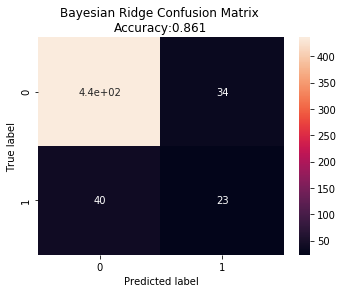

RMSE: 	 2.7792065146711966
r2: 	 -0.8390229449401232
Accuracy: 	 0.8611632270168855
Recall: 	 0.36507936507936506
Precision: 	 0.40350877192982454
Specificity: 	 0.9276595744680851
NPV: 	 0.9159663865546218
F1: 		 0.38333333333333336


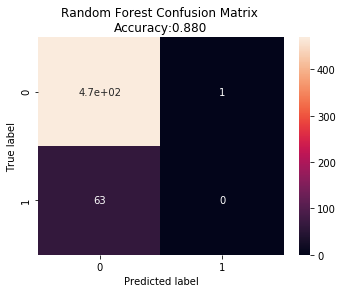

RMSE: 	 1.528007358765895
r2: 	 -0.011094561693731242
Accuracy: 	 0.8799249530956847
Recall: 	 0.0
Precision: 	 0.0
Specificity: 	 0.997872340425532
NPV: 	 0.881578947368421
F1: 		 0.0


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.9276729	test: 1.1397239	best: 1.1397239 (0)	total: 87.5ms	remaining: 14m 34s
10:	learn: 0.9034678	test: 1.1163094	best: 1.1163094 (10)	total: 472ms	remaining: 7m 8s
20:	learn: 0.8834011	test: 1.1001231	best: 1.1001231 (20)	total: 798ms	remaining: 6m 19s
30:	learn: 0.8649978	test: 1.0826210	best: 1.0826210 (30)	total: 1.13s	remaining: 6m 3s
40:	learn: 0.8475750	test: 1.0675917	best: 1.0675917 (40)	total: 1.46s	remaining: 5m 55s
50:	learn: 0.8311326	test: 1.0502912	best: 1.0502912 (50)	total: 1.79s	remaining: 5m 50s
60:	learn: 0.8157475	test: 1.0371055	best: 1.0371055 (60)	total: 2.14s	remaining: 5m 48s
70:	learn: 0.8015711	test: 1.0291674	best: 1.0291674 (70)	total: 2.48s	remaining: 5m 46s
80:	learn: 0.7887078	test: 1.0204074	best: 1.0204074 (80)	total: 2.81s	remaining: 5m 43s
90:	learn: 0.7772234	test: 1.0139237	best: 1.0139237 (90)	total: 3.16s	remaining: 5m 43s
100:	learn: 0.7669765	test: 1.0053101	best: 1.0053101 (100)	total: 3.49s	remaining: 5m 41s
110:	learn: 0.7565238

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7231047	test: 0.6960634	best: 0.6960634 (0)	total: 81.1ms	remaining: 13m 31s
10:	learn: 0.7036797	test: 0.6867296	best: 0.6867296 (10)	total: 533ms	remaining: 8m 3s
20:	learn: 0.6863852	test: 0.6782909	best: 0.6782909 (20)	total: 865ms	remaining: 6m 50s
30:	learn: 0.6709653	test: 0.6701579	best: 0.6701579 (30)	total: 1.2s	remaining: 6m 26s
40:	learn: 0.6570676	test: 0.6623280	best: 0.6623280 (40)	total: 1.53s	remaining: 6m 12s
50:	learn: 0.6434654	test: 0.6559067	best: 0.6559067 (50)	total: 1.86s	remaining: 6m 3s
60:	learn: 0.6312953	test: 0.6506831	best: 0.6506831 (60)	total: 2.2s	remaining: 5m 58s
70:	learn: 0.6192651	test: 0.6467470	best: 0.6464638 (69)	total: 2.54s	remaining: 5m 54s
80:	learn: 0.6081578	test: 0.6423635	best: 0.6423635 (80)	total: 2.87s	remaining: 5m 51s
90:	learn: 0.5985411	test: 0.6378699	best: 0.6378699 (90)	total: 3.21s	remaining: 5m 49s
100:	learn: 0.5890646	test: 0.6336686	best: 0.6336686 (100)	total: 3.54s	remaining: 5m 46s
110:	learn: 0.5805362	t

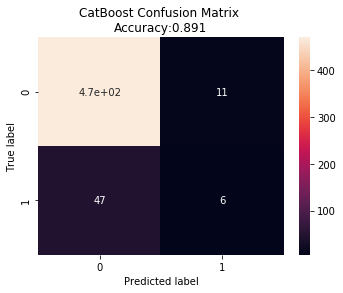

RMSE: 	 1.4212483874352826
r2: 	 0.07130750241819728
Accuracy: 	 0.8911819887429644
Recall: 	 0.11320754716981132
Precision: 	 0.35294117647058826
Specificity: 	 0.9770833333333333
NPV: 	 0.9089147286821705
F1: 		 0.17142857142857143


In [0]:
ls_upsample_result = []
svm_upsample_result = []
br_upsample_result = []
rf_upsample_result = []
cat_upsample_result = []

for i in range(4):
  # Split the data: one-hot encoding
  X_oh_train = X_oh.iloc[gkf_modeling[i][0],]
  X_oh_test = X_oh.iloc[gkf_modeling[i][1],]
  y_oh_train = y_oh.iloc[gkf_modeling[i][0],]
  y_oh_test = y_oh.iloc[gkf_modeling[i][1],]

  # Split the data: categorical
  X_cat_train = X_cat.iloc[gkf_modeling[1][0],]
  X_cat_test = X_cat.iloc[gkf_modeling[1][1],]
  y_cat_train = y_cat.iloc[gkf_modeling[1][0],]
  y_cat_test = y_cat.iloc[gkf_modeling[1][1],]
  
  # Upsample and Scale
  X_oh_upsample_train_scaled, y_oh_upsample_train, X_oh_test_scaled = upsample_data_with_oh(X_oh_train, y_oh_train, X_oh_test)
  X_cat_upsample_train, y_cat_upsample_train = upsample_data_with_cat(X_cat_train, y_cat_train)

  # Lasso
  ls_res = model_eval(Lasso(max_iter=20000), 'Lasso', 'up')
  ls_upsample_result.append(ls_res)
  # SVM
  svm_res = model_eval(svm.SVR(), 'SVM', 'up')
  svm_upsample_result.append(svm_res)
  # Bayesian Ridge
  br_res = model_eval(BayesianRidge(), 'Bayesian Ridge', 'up')
  br_upsample_result.append(br_res)
  # Random Forest
  rf_res = model_eval(RandomForestRegressor(), 'Random Forest', 'up')
  rf_upsample_result.append(rf_res)
  # CatBoost
  cat_res = model_eval('God bless this model', 'CatBoost', 'up')
  cat_upsample_result.append(cat_res)

ii. Post Processing

In [0]:
ls_avg_eval = np.mean(ls_upsample_result, axis=0)
ls_avg_eval = np.append('Lasso', ls_avg_eval)

svm_avg_eval = np.mean(svm_upsample_result, axis=0)
svm_avg_eval = np.append('SVM', svm_avg_eval)

br_avg_eval = np.mean(br_upsample_result, axis=0)
br_avg_eval = np.append('Bayesian Ridge', br_avg_eval)

rf_avg_eval = np.mean(rf_upsample_result, axis=0)
rf_avg_eval = np.append('Random Forest', rf_avg_eval)

cat_avg_eval = np.mean(cat_upsample_result, axis=0)
cat_avg_eval = np.append('CatBoost', cat_avg_eval)

data = [ls_avg_eval, svm_avg_eval, br_avg_eval, rf_avg_eval, cat_avg_eval]
cv_upsample_res = pd.DataFrame(data=data, columns=['model', 'RMSE', 'r2', 'accuracy', 'recall', 'precision', 'specificity', 'npv', 'f1'])

iii. Result

In [0]:
# For Random Split
cv_upsample_res

,model,RMSE,r2,accuracy,recall,precision,specificity,npv,f1
0,Lasso,2.4555629517260487,-0.7579783408523931,0.8902869419791865,0.0,0.0,1.0,0.8902869419791865,0.0
1,SVM,1.8111235722923644,-0.29156845084958366,0.8391612384144584,0.12326002317798872,0.15103383458646616,0.9261521001467352,0.8959099442951421,0.10908870282732677
2,Bayesian Ridge,2.695967097401911,-0.9083505600466437,0.7631753694373591,0.3132162900708547,0.42223057644110273,0.8159486579848374,0.9062816688690242,0.21304392738603267
3,Random Forest,1.6184277203331672,-0.16719653599059436,0.8687109569885674,0.08264971287940935,0.175,0.9640154988994865,0.8954258962935822,0.09823717948717949
4,CatBoost,1.4212483874352826,0.07130750241819728,0.8911819887429644,0.11320754716981132,0.35294117647058826,0.9770833333333333,0.9089147286821705,0.17142857142857143


In [0]:
# For stratified split
cv_upsample_res

,model,RMSE,r2,accuracy,recall,precision,specificity,npv,f1
0,Lasso,2.4555629517260487,-0.7579783408523931,0.8902869419791865,0.0,0.0,1.0,0.8902869419791865,0.0
1,SVM,1.8111235722923644,-0.29156845084958366,0.8391612384144584,0.12326002317798872,0.15103383458646616,0.9261521001467352,0.8959099442951421,0.10908870282732677
2,Bayesian Ridge,2.695967097401911,-0.9083505600466437,0.7631753694373591,0.3132162900708547,0.42223057644110273,0.8159486579848374,0.9062816688690242,0.21304392738603267
3,Random Forest,1.6184277203331672,-0.16719653599059436,0.8687109569885674,0.08264971287940935,0.175,0.9640154988994865,0.8954258962935822,0.09823717948717949
4,CatBoost,1.4212483874352826,0.07130750241819728,0.8911819887429644,0.11320754716981132,0.35294117647058826,0.9770833333333333,0.9089147286821705,0.17142857142857143


### *Could further look into feature importance*

## 10.Under Sample Majority Class

### (1) Undersample for Data with categorical features

In [0]:
def undersample_data_with_cat(X_train, y_train):
  # concatenate our training data back together
  data_cat_to_sample = pd.concat([X_train, y_train], axis=1)

  # separate minority and majority classes
  unhappy_cat = data_cat_to_sample[data_cat_to_sample['valence_score'] < 0]
  happy_cat = data_cat_to_sample[data_cat_to_sample['valence_score'] >= 0]
  # downsample majority
  happy_cat_downsampled = resample(happy_cat,
                                  replace = False, # sample without replacement
                                  n_samples = len(unhappy_cat), # match minority n
                                  random_state = 27) # reproducible results

  # combine minority and downsampled majority
  downsampled_cat = pd.concat([happy_cat_downsampled, unhappy_cat])

  # checking counts
  print(downsampled_cat[downsampled_cat['valence_score']>=0].shape)
  print(downsampled_cat[downsampled_cat['valence_score']<0].shape)

  # Split train and test
  y_cat_downsample_train = downsampled_cat['valence_score']
  X_cat_downsample_train = downsampled_cat.drop('valence_score', axis=1)
  return X_cat_downsample_train, y_cat_downsample_train

X_cat_downsample_train, y_cat_downsample_train = undersample_data_with_cat(X_cat_train, y_cat_train)

KeyError: ignored

### (2) Undersample for Data with one-hot encoding

In [0]:
def downsample_data_with_oh(X_train, y_train, X_test):
  # concatenate our training data back together
  data_oh_to_sample = pd.concat([X_oh_train, y_oh_train], axis=1)


  # separate minority and majority classes
  unhappy_oh = data_oh_to_sample[data_oh_to_sample['valence_score'] < 0]
  happy_oh = data_oh_to_sample[data_oh_to_sample['valence_score'] >= 0]


  # upsample minority
  happy_oh_downsampled = resample(happy_oh,
                            replace=True, # sample with replacement
                            n_samples=len(unhappy_oh), # match number in majority class
                            random_state=27) # reproducible results

  # combine majority and upsampled minority
  downsampled_oh = pd.concat([unhappy_oh, happy_oh_downsampled])

  # check new class counts
  print(downsampled_oh[downsampled_oh['valence_score']>=0].shape)
  print(downsampled_oh[downsampled_oh['valence_score']<0].shape)

  # Split train and test
  y_oh_downsample_train = downsampled_oh['valence_score']
  X_oh_downsample_train = downsampled_oh.drop('valence_score', axis=1)

  # Scale for logistic regression
  scaler = preprocessing.StandardScaler().fit(X_oh_downsample_train)
  X_oh_downsample_train_scaled = scaler.transform(X_oh_downsample_train)
  X_oh_test_scaled = scaler.transform(X_test)
  return X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled


X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled = downsample_data_with_oh(X_oh_train, y_oh_train, X_oh_test)


### (3) Lasso Regression

In [0]:
def model_eval(model, model_name, sample_type):
  if sample_type == 'up':
    X_cat_train = X_cat_upsample_train
    y_cat_train = y_cat_upsample_train
    X_oh_train = X_oh_upsample_train_scaled
    y_oh_train = y_oh_upsample_train
  elif sample_type == 'down':
    X_cat_train = X_cat_downsample_train
    y_cat_train = y_cat_downsample_train
    X_oh_train = X_oh_downsample_train_scaled
    y_oh_train = y_oh_downsample_train

  if model_name == 'CatBoost':
    cat = catboost.CatBoostRegressor(**params_2)
    cat.fit(X_cat_train, y_cat_train,
              eval_set = (X_cat_test, y_cat_test),
              cat_features = categorical_features_indices,
              use_best_model = True,
              plot=True)
    m_regr = cat.predict(X_cat_test)
    return eval(y_cat_test, m_regr, model_name)
  else:
    model.fit(X_oh_train, y_oh_train)
    m_regr = model.predict(X_oh_test_scaled)
    return eval(y_oh_test, m_regr, model_name)

In [0]:
ls = model_eval(Lasso(max_iter=20000), 'Lasso', 'down')

### (4) SVM

In [0]:
svm_ = model_eval(svm.SVR(), 'SVM', 'down')

### (5) Bayesian Ridge

In [0]:
br = model_eval(BayesianRidge(), 'Bayesian Ridge', 'down')

### (6) Random Forest

In [0]:
rf = model_eval(RandomForestRegressor(), 'Bayesian Ridge', 'down')

### (7) CatBoost

In [0]:
cat = model_eval('wow here I can type anything', 'CatBoost', 'down')

### (8) Cross Validation

i. Cross validation for CatBoost, Stratified split

In [0]:
cat_upsample_result = []
skf = StratifiedKFold(n_splits=4, random_state=27, shuffle=False)
for train_index, test_index in skf.split(X_cat, group_cat):
  # Stratified Split
  X_cat_train, X_cat_test = X_cat.iloc[train_index], X_cat.iloc[test_index]
  y_cat_train, y_cat_test = y_cat.iloc[train_index], y_cat.iloc[test_index]
  # Down sample
  X_cat_downsample_train, y_cat_downsample_train = undersample_data_with_cat(X_cat_train, y_cat_train)
  # CatBoost
  cat_res = model_pn(None, X_cat_downsample_train, y_cat_downsample_train, X_cat_test, y_cat_test, 'CatBoost')
  cat_upsample_result.append(cat_res)

ii. Cross validation for Lasso, SVM, Bayesian Ridge RandomForest with Stratified split

In [0]:
ls_upsample_result = []
svm_upsample_result = []
br_upsample_result = []
rf_upsample_result = []

skf = StratifiedKFold(n_splits=4, random_state=27, shuffle=False)
for train_index, test_index in skf.split(X_oh, group_oh):
  # Stratified Split
  X_oh_train, X_oh_test = X_oh.iloc[train_index], X_oh.iloc[test_index]
  y_oh_train, y_oh_test = y_oh.iloc[train_index], y_oh.iloc[test_index]
  # Up sample
  X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled = downsample_data_with_oh(X_oh_train, y_oh_train, X_oh_test)
  # Lasso
  ls_res = model_pn(Lasso(max_iter=20000), X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled, y_oh_test, 'Lasso')
  ls_upsample_result.append(ls_res)
  # SVM
  svm_res = model_pn(svm.SVR(), X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled, y_oh_test, 'SVM')
  svm_upsample_result.append(svm_res)
  # Bayesian Ridge
  br_res = model_pn(BayesianRidge(), X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled, y_oh_test, 'Bayesian Ridge')
  br_upsample_result.append(br_res)
  # Random Forest
  rf_res = model_pn(RandomForestRegressor(), X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled, y_oh_test, 'Random Forest')
  rf_upsample_result.append(rf_res)

In [0]:
ls_downsample_result = []
svm_downsample_result = []
br_downsample_result = []
rf_downsample_result = []
cat_downsample_result = []

for i in range(4):
  # Split the data: one-hot encoding
  X_oh_train = X_oh.iloc[gkf_modeling[i][0],]
  X_oh_test = X_oh.iloc[gkf_modeling[i][1],]
  y_oh_train = y_oh.iloc[gkf_modeling[i][0],]
  y_oh_test = y_oh.iloc[gkf_modeling[i][1],]

  # Split the data: categorical
  X_cat_train = X_cat.iloc[gkf_modeling[1][0],]
  X_cat_test = X_cat.iloc[gkf_modeling[1][1],]
  y_cat_train = y_cat.iloc[gkf_modeling[1][0],]
  y_cat_test = y_cat.iloc[gkf_modeling[1][1],]
  
  # Upsample and Scale
  X_oh_downsample_train_scaled, y_oh_downsample_train, X_oh_test_scaled = downsample_data_with_oh(X_oh_train, y_oh_train, X_oh_test)
  X_cat_downsample_train, y_cat_downsample_train = undersample_data_with_cat(X_cat_train, y_cat_train)
  
  # Lasso
  ls_res = model_eval(Lasso(max_iter=20000), 'Lasso', 'down')
  ls_downsample_result.append(ls_res)
  # SVM
  svm_res = model_eval(svm.SVR(), 'SVM', 'down')
  svm_downsample_result.append(svm_res)
  # Bayesian Ridge
  br_res = model_eval(BayesianRidge(), 'Bayesian Ridge', 'down')
  br_downsample_result.append(br_res)
  # Random Forest
  rf_res = model_eval(RandomForestRegressor(), 'Random Forest', 'down')
  rf_downsample_result.append(rf_res)
  # CatBoost
  cat_res = model_eval('God bless this model', 'CatBoost', 'down')
  cat_downsample_result.append(cat_res)
  

ii. Post processing

In [0]:
ls_avg_eval = np.mean(ls_downsample_result, axis=0)
ls_avg_eval = np.append('Lasso', ls_avg_eval)

svm_avg_eval = np.mean(svm_downsample_result, axis=0)
svm_avg_eval = np.append('SVM', svm_avg_eval)

br_avg_eval = np.mean(br_downsample_result, axis=0)
br_avg_eval = np.append('Bayesian Ridge', br_avg_eval)

rf_avg_eval = np.mean(rf_downsample_result, axis=0)
rf_avg_eval = np.append('Random Forest', rf_avg_eval)

cat_avg_eval = np.mean(cat_downsample_result, axis=0)
cat_avg_eval = np.append('CatBoost', cat_avg_eval)

data = [ls_avg_eval, svm_avg_eval, br_avg_eval, rf_avg_eval, cat_avg_eval]
cv_downsample_res = pd.DataFrame(data=data, columns=['model', 'RMSE', 'r2', 'accuracy', 'recall', 'precision', 'specificity', 'npv', 'f1'])

iii. Result

In [0]:
cv_downsample_res

## 11.Conclusion

1. Over Sample Minority + SVM gives best performance:

* Recall: 	 0.12
* Precision: 	 0.15
* Accuracy: 0.84
* F1: 0.11

2. In general, the accuracy of regression model is better than classification model. But the ability to detect unhappy case is worse than classification model.